In [1]:
import tensorflow as tf
#from tensorflow.keras import layers
#from tensorflow.keras import models
from tensorflow.keras.layers import Dense, Flatten, LSTM,Dropout,Conv2D,TimeDistributed
from tensorflow.keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, Flatten, Dense, LSTM, TimeDistributed, Dropout
import matplotlib.pyplot as plt
import numpy as np   
from tensorflow.keras.layers import (Conv2D, TimeDistributed, MaxPooling2D,
                                     MaxPooling3D, AveragePooling2D, Conv2DTranspose, UpSampling2D,
                                     BatchNormalization,
                                     Dense, Flatten, Reshape,Dropout)

In [2]:
real_signals_train=np.load('../data_for_OGAN/X_eeg_train.npy')
real_signals_test=np.load('../data_for_OGAN/X_eeg_test.npy')

generated_signals=np.load("X_generated_train.npy")
generated_signals_test=np.load("X_generated_test2.npy")

In [3]:
generated_signals_test.shape

(5400, 32, 14)

In [4]:
y_train=np.load('../data_for_OGAN/X_eeg_train.npy')
y_test=np.load('../data_for_OGAN/X_eeg_test.npy')

y_train = np.moveaxis(y_train, 1, 2)
y_test=np.moveaxis(y_test,1,2)
print(y_train.shape)
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
y_train = scaler.fit_transform(y_train.reshape(-1, y_train.shape[-1])).reshape(y_train.shape)
y_test = scaler.fit_transform(y_test.reshape(-1, y_test.shape[-1])).reshape(y_test.shape)

squeezed_data = np.squeeze(y_train, axis=-1)
squeezed_data1 = np.squeeze(y_test, axis=-1)

print(squeezed_data.shape)
#eeg_data= squeezed_data
main_EEG = squeezed_data[:, :, 6]  # 6 ,7 o1,o2
print(main_EEG.shape)
y_train1=main_EEG
y_test1=squeezed_data1[:,:,6]
y_train1=np.expand_dims(y_train1,axis=-1)
y_test1=np.expand_dims(y_test1,axis=-1)
print(y_test1.shape)


(40000, 32, 14, 1)
(40000, 32, 14)
(40000, 32)
(5400, 32, 1)


In [5]:
import json
a=json.dumps(["a", "b", "c"])
b=json.loads(a)
b[0]

'a'

In [6]:
real_signals_train.shape

(40000, 14, 32, 1)

In [7]:
generated_signals.shape

(40000, 32, 14)

In [8]:
squeezed_data.shape

(40000, 32, 14)

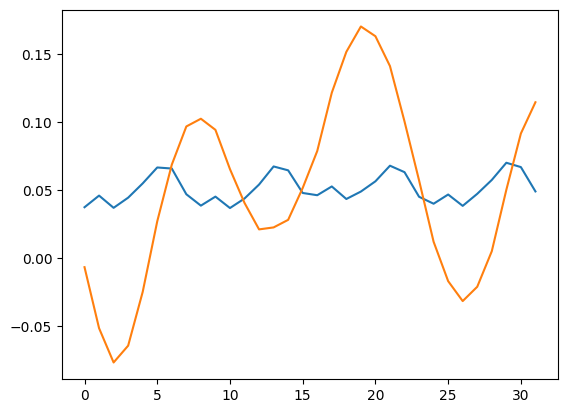

In [9]:
"""for i in range(10):
    plt.plot(squeezed_data[i,:,6])"""
plt.plot(np.mean(squeezed_data[4000:8000,:,6],axis=0))
plt.plot(np.mean(generated_signals[4000:8000,:,6],axis=0))

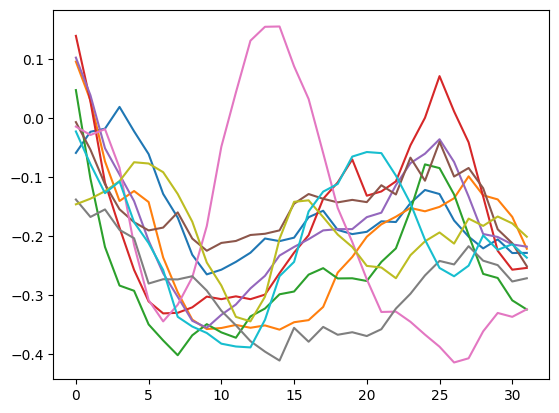

In [10]:
for i in range(10):
    plt.plot(generated_signals[i,:,6])

In [11]:
generated_signals.shape

(40000, 32, 14)

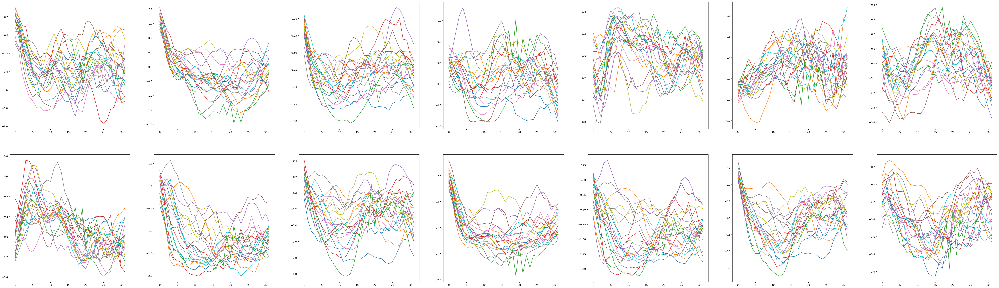

In [12]:
fig,axs=plt.subplots(2,7,figsize=(70,20))
i=4
k=0
for m in range(2):
    for j in range(7):
        a_gen=generated_signals[4000*i:4000*(i+1)]
        for p in range(20):
            axs[m,j].plot(a_gen[20*p,:,k])
        k+=1

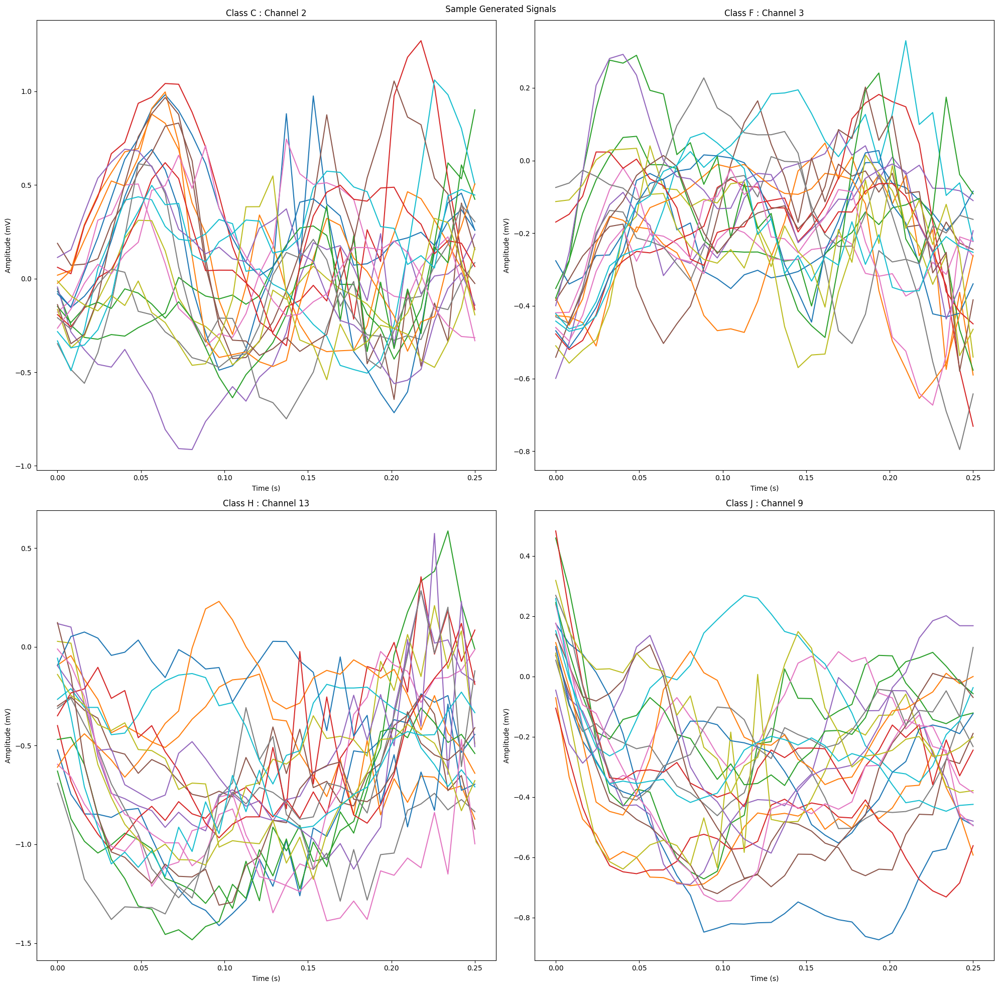

In [13]:
fig,axs=plt.subplots(2,2,figsize=(20,20))
plt.suptitle(" Sample Generated Signals")
class_ids=[1,2,3,4]
channel_ids=[2,3,13,9]
class_labels = ['A', 'C', 'F', 'H', 'J', 'M', 'P', 'S', 'T', 'Y']
k=0
for i in range(2):
    for j in range(2):
        a_gen=generated_signals[4000*class_ids[k]:4000*(class_ids[k]+1)]
        for p in range(20):
            x_labels=np.linspace(0, 0.25, 32)
            axs[i,j].plot(x_labels,a_gen[200*p,:,channel_ids[k]])
            axs[i,j].set_xlabel("Time (s)")
            axs[i,j].set_ylabel("Amplitude (mV)")
        axs[i,j].set_title("Class {} : Channel {}".format(class_labels[class_ids[k]],channel_ids[k]))
        k+=1
plt.tight_layout()

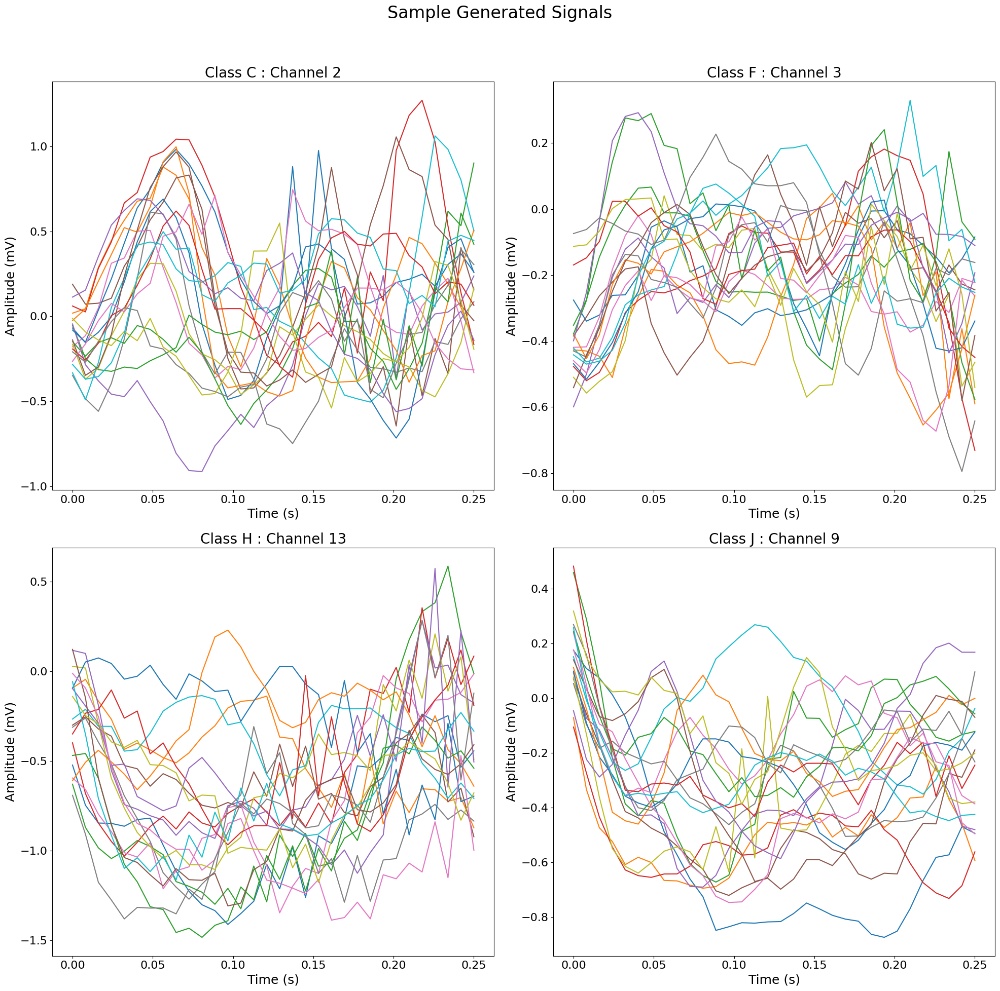

In [14]:
fig, axs = plt.subplots(2, 2, figsize=(20, 20))
plt.suptitle("Sample Generated Signals", fontsize=24)  # Increased title font size
plt.rcParams.update({'font.size': 16})  # Increase the global font size

class_ids = [1, 2, 3, 4]
channel_ids = [2, 3, 13, 9]
class_labels = ['A', 'C', 'F', 'H', 'J', 'M', 'P', 'S', 'T', 'Y']
k = 0

for i in range(2):
    for j in range(2):
        a_gen = generated_signals[4000*class_ids[k]:4000*(class_ids[k]+1)]
        for p in range(20):
            x_labels = np.linspace(0, 0.25, 32)
            axs[i, j].plot(x_labels, a_gen[200*p, :, channel_ids[k]])
            axs[i, j].set_xlabel("Time (s)", fontsize=18)  # Increased x-label font size
            axs[i, j].set_ylabel("Amplitude (mV)", fontsize=18)  # Increased y-label font size
        
        axs[i, j].set_title("Class {} : Channel {}".format(class_labels[class_ids[k]], channel_ids[k]), fontsize=20)  # Increased subplot title font size
        axs[i, j].tick_params(axis='both', which='major', labelsize=16)  # Increased tick label font size
        k += 1

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust layout to accommodate the larger title
plt.show()

Real data shape: (40000, 32, 14)
Generated data shape: (40000, 32, 14)


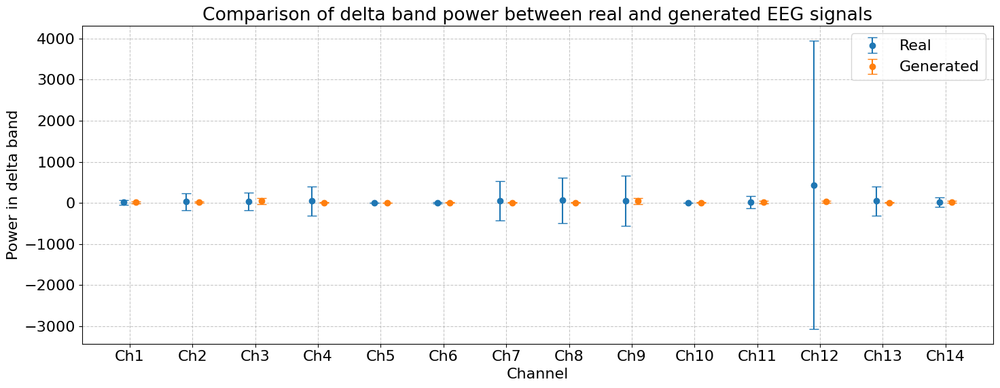

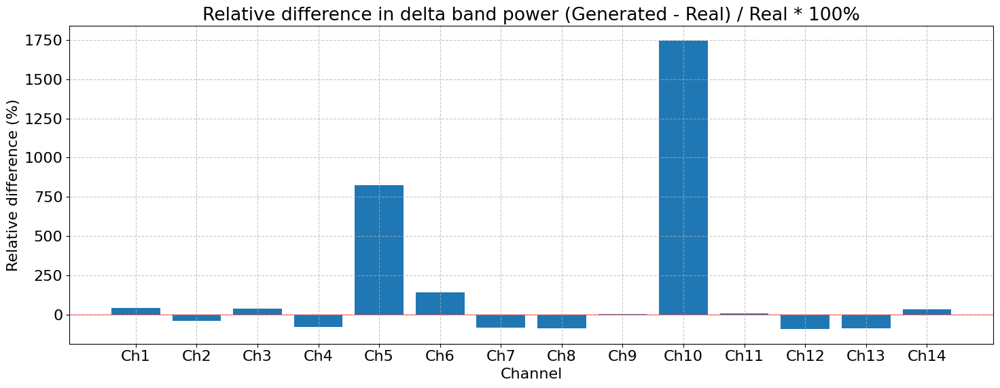

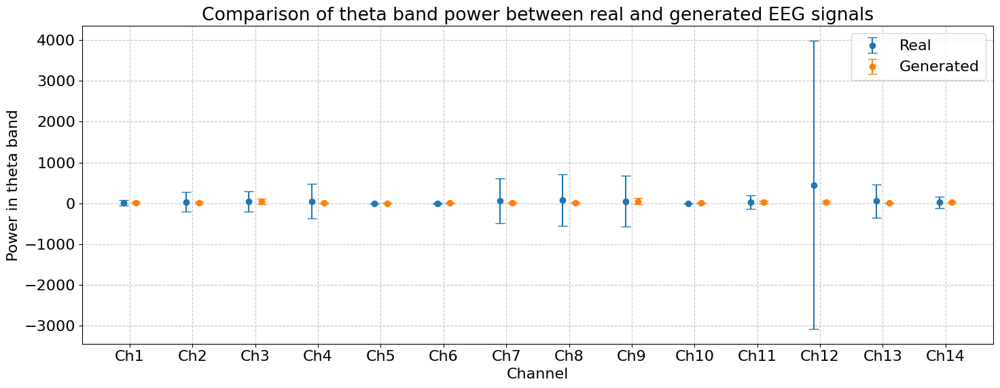

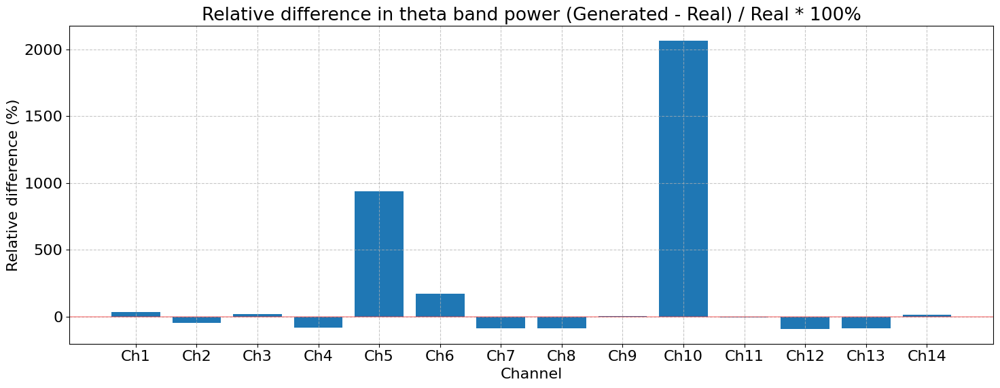

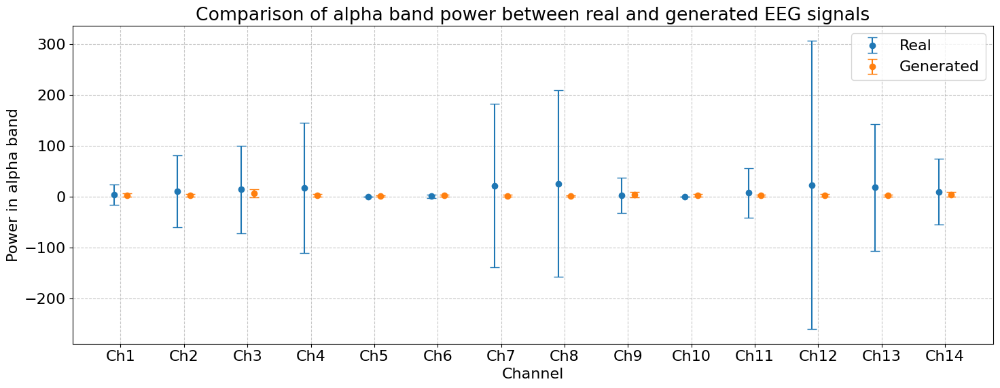

...

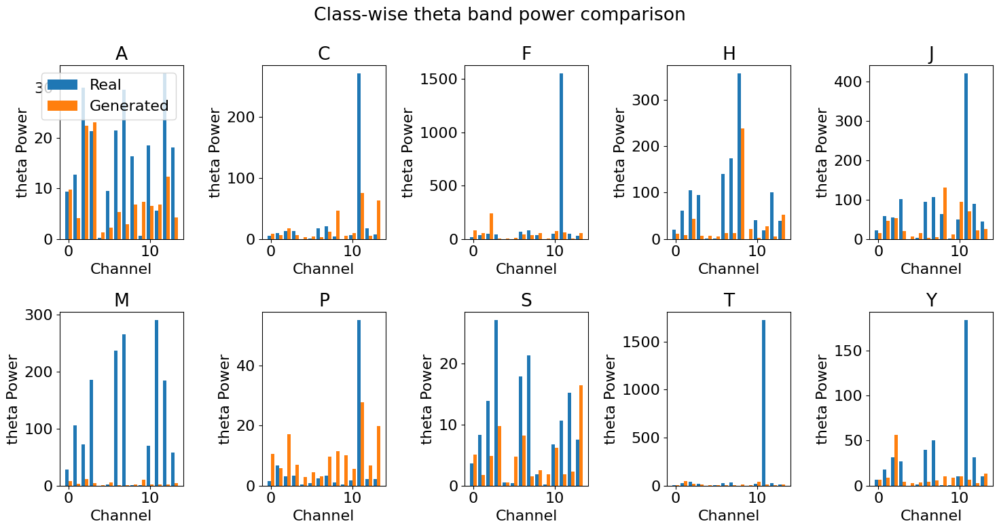

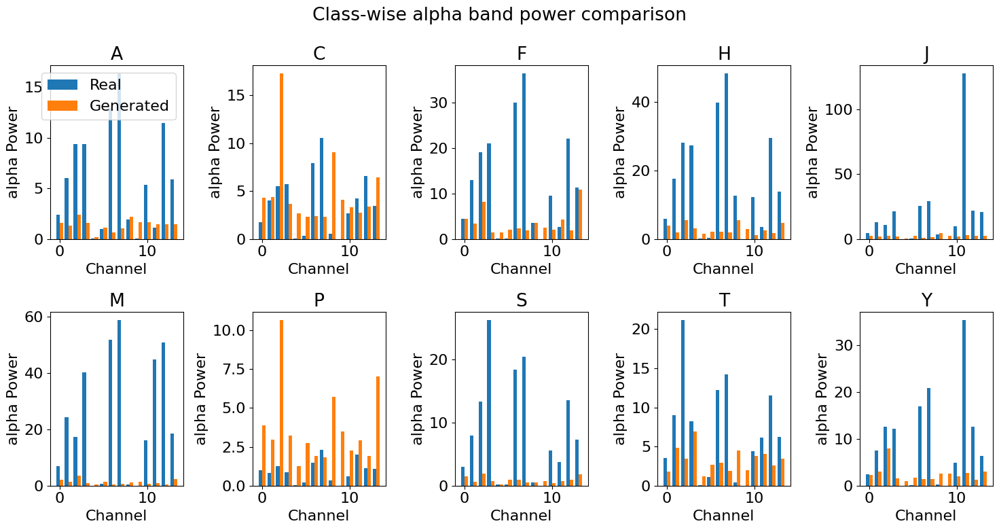

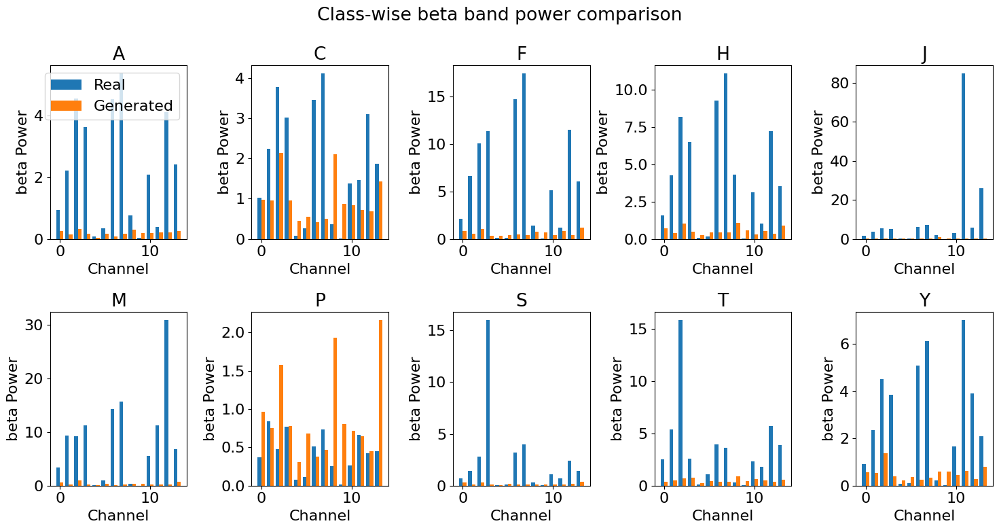

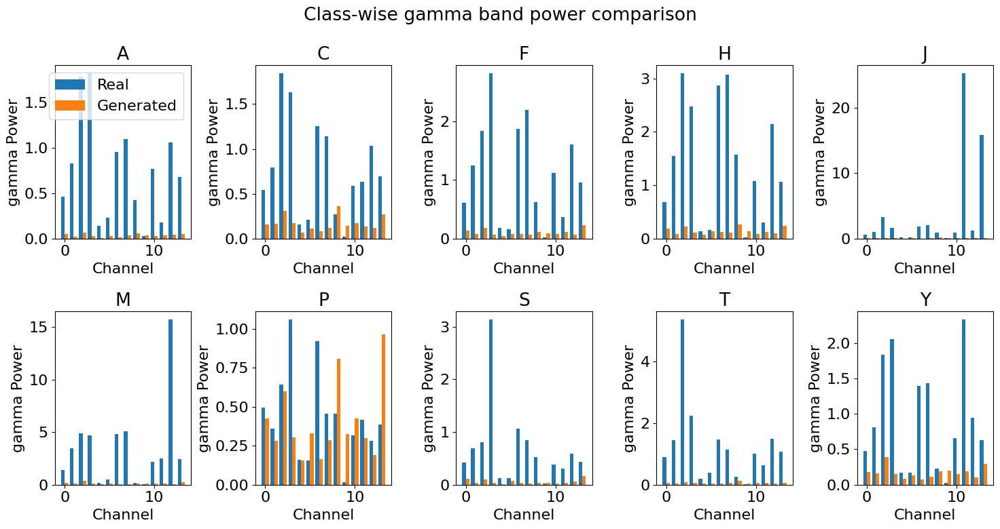

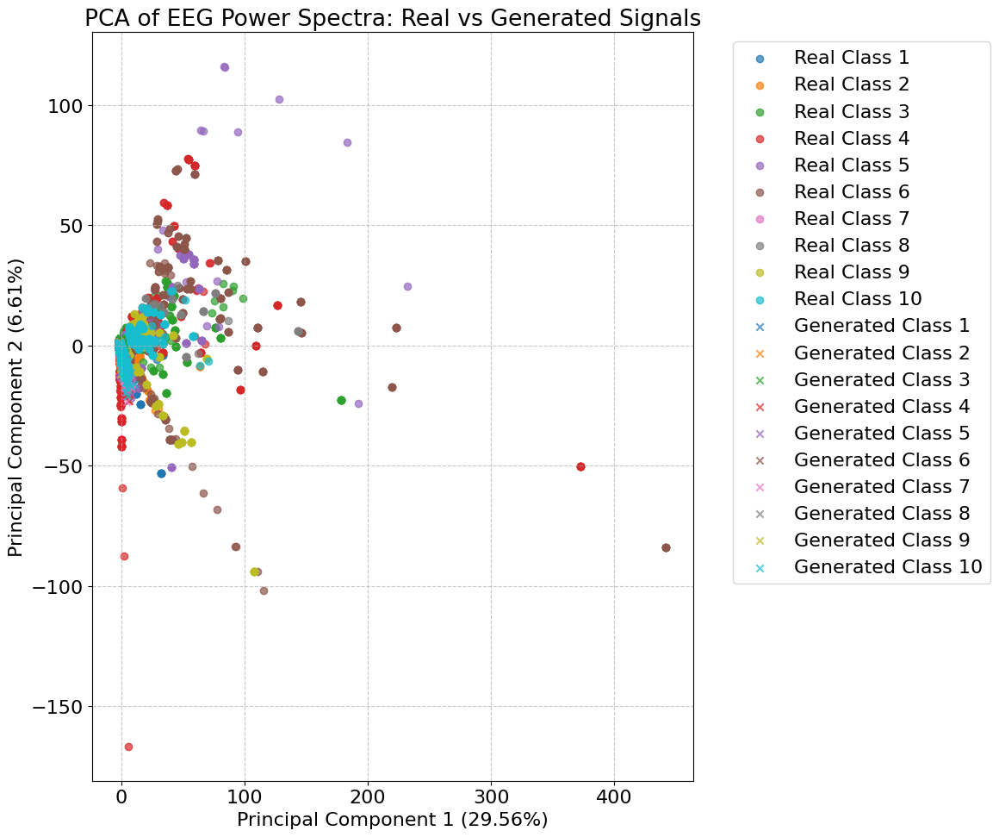

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy.fft import fft, fftfreq
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

def load_eeg_data(file_path):
    """
    Load the EEG data from numpy files
    
    Args:
        file_path: Path to the numpy file containing EEG data
        
    Returns:
        data: Loaded numpy array
    """
    return np.load(file_path)

def compute_power_spectrum(eeg_data, fs=100):
    """
    Compute power spectrum for each channel in the EEG data
    
    Args:
        eeg_data: Numpy array of shape (n_samples, n_channels, n_timepoints)
        fs: Sampling frequency in Hz (default: 100 Hz)
        
    Returns:
        power_spectra: Power spectra for each channel and sample
        frequencies: Frequency bins
    """
    eeg_data=np.transpose(eeg_data, (0, 2, 1))
    n_samples, n_channels, n_timepoints = eeg_data.shape
    
    # Calculate the frequencies
    frequencies = fftfreq(n_timepoints, 1.0/fs)
    # Take only positive frequencies
    pos_freq_idx = np.where(frequencies >= 0)
    frequencies = frequencies[pos_freq_idx]
    
    # Initialize power spectra array
    power_spectra = np.zeros((n_samples, n_channels, len(frequencies)))
    
    # Compute power spectrum for each sample and channel
    for i in range(n_samples):
        for j in range(n_channels):
            # Apply Hamming window
            windowed_signal = eeg_data[i, j, :] * signal.windows.hamming(n_timepoints)
            
            # Compute FFT
            signal_fft = fft(windowed_signal)
            
            # Take absolute value and square to get power
            power = np.abs(signal_fft) ** 2
            
            # Take only positive frequencies
            power_spectra[i, j, :] = power[pos_freq_idx]
    
    return power_spectra, frequencies

def compute_band_power(power_spectra, frequencies, bands):
    """
    Compute power in specified frequency bands
    
    Args:
        power_spectra: Power spectra array (n_samples, n_channels, n_frequencies)
        frequencies: Frequency bins
        bands: Dictionary of frequency bands {band_name: (low_freq, high_freq)}
        
    Returns:
        band_powers: Dictionary of band powers {band_name: powers}
    """
    n_samples, n_channels, _ = power_spectra.shape
    band_powers = {}
    
    for band_name, (low_freq, high_freq) in bands.items():
        # Find indices of frequencies within the band
        band_idx = np.where((frequencies >= low_freq) & (frequencies <= high_freq))[0]
        
        if len(band_idx) == 0:
            continue
            
        # Initialize band power array
        band_power = np.zeros((n_samples, n_channels))
        
        # Sum power across the band for each sample and channel
        for i in range(n_samples):
            for j in range(n_channels):
                band_power[i, j] = np.sum(power_spectra[i, j, band_idx])
        
        band_powers[band_name] = band_power
    
    return band_powers

def analyze_power_differences(real_powers, generated_powers, bands, class_labels=None):
    """
    Analyze differences in power between real and generated EEG signals
    
    Args:
        real_powers: Dictionary of band powers for real signals
        generated_powers: Dictionary of band powers for generated signals
        bands: Dictionary of frequency bands
        class_labels: List of class labels
        
    Returns:
        stats: Dictionary of statistics
    """
    stats = {}
    
    for band_name in bands.keys():
        if band_name not in real_powers or band_name not in generated_powers:
            continue
            
        real_band_power = real_powers[band_name]
        generated_band_power = generated_powers[band_name]
        
        # Compute mean power for each channel
        mean_real = np.mean(real_band_power, axis=0)
        mean_generated = np.mean(generated_band_power, axis=0)
        
        # Compute standard deviation for each channel
        std_real = np.std(real_band_power, axis=0)
        std_generated = np.std(generated_band_power, axis=0)
        
        # Compute relative difference
        rel_diff = (mean_generated - mean_real) / mean_real * 100
        
        stats[band_name] = {
            'mean_real': mean_real,
            'mean_generated': mean_generated,
            'std_real': std_real,
            'std_generated': std_generated,
            'relative_difference_percent': rel_diff
        }
    
    return stats

def visualize_power_comparison(real_data, generated_data, bands, class_labels=None, n_classes=10):
    """
    Visualize power comparison between real and generated EEG signals
    
    Args:
        real_data: Real EEG data
        generated_data: Generated EEG data
        bands: Dictionary of frequency bands
        class_labels: List of class labels
        n_classes: Number of classes
    """
    # Compute power spectra
    fs = 128  # Assuming 100 Hz sampling rate
    real_power_spectra, frequencies = compute_power_spectrum(real_data, fs)
    generated_power_spectra, _ = compute_power_spectrum(generated_data, fs)
    
    # Compute band powers
    real_band_powers = compute_band_power(real_power_spectra, frequencies, bands)
    generated_band_powers = compute_band_power(generated_power_spectra, frequencies, bands)
    
    # Analyze power differences
    stats = analyze_power_differences(real_band_powers, generated_band_powers, bands, class_labels)
    
    # Plot band power comparison for each band
    for band_name, band_stats in stats.items():
        plt.figure(figsize=(15, 6))
        
        # Number of channels
        n_channels = len(band_stats['mean_real'])
        channels = np.arange(n_channels)
        
        # Plot mean power with error bars
        plt.errorbar(channels - 0.1, band_stats['mean_real'], yerr=band_stats['std_real'], 
                     fmt='o', label='Real', capsize=5)
        plt.errorbar(channels + 0.1, band_stats['mean_generated'], yerr=band_stats['std_generated'], 
                     fmt='o', label='Generated', capsize=5)
        
        plt.xlabel('Channel')
        plt.ylabel(f'Power in {band_name} band')
        plt.title(f'Comparison of {band_name} band power between real and generated EEG signals')
        plt.xticks(channels, [f'Ch{i+1}' for i in channels])
        plt.legend()
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.tight_layout()
        
        # Plot relative difference
        plt.figure(figsize=(15, 6))
        plt.bar(channels, band_stats['relative_difference_percent'])
        plt.axhline(y=0, color='r', linestyle='-', alpha=0.3)
        plt.xlabel('Channel')
        plt.ylabel('Relative difference (%)')
        plt.title(f'Relative difference in {band_name} band power (Generated - Real) / Real * 100%')
        plt.xticks(channels, [f'Ch{i+1}' for i in channels])
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.tight_layout()
    
    # Class-wise analysis if class information is available
    if class_labels is not None or n_classes > 0:
        samples_per_class = len(real_data) // n_classes
        
        for band_name in bands.keys():
            if band_name not in real_band_powers or band_name not in generated_band_powers:
                continue
                
            plt.figure(figsize=(15, 8))
            
            for c in range(n_classes):
                class_start = c * samples_per_class
                class_end = (c + 1) * samples_per_class
                
                real_class_power = np.mean(real_band_powers[band_name][class_start:class_end], axis=0)
                generated_class_power = np.mean(generated_band_powers[band_name][class_start:class_end], axis=0)
                
                plt.subplot(2, 5, c+1)
                plt.bar(np.arange(len(real_class_power)) - 0.2, real_class_power, width=0.4, label='Real')
                plt.bar(np.arange(len(generated_class_power)) + 0.2, generated_class_power, width=0.4, label='Generated')
                
                class_name = class_labels[c] if class_labels is not None else f'Class {c+1}'
                plt.title(f'{class_name}')
                plt.xlabel('Channel')
                plt.ylabel(f'{band_name} Power')
                
                if c == 0:
                    plt.legend()
            
            plt.suptitle(f'Class-wise {band_name} band power comparison')
            plt.tight_layout()

def pca_analysis(real_data, generated_data, n_components=2, n_classes=10):
    """
    Perform PCA analysis on power spectra of real and generated EEG signals
    
    Args:
        real_data: Real EEG data
        generated_data: Generated EEG data
        n_components: Number of PCA components
        n_classes: Number of classes
    """
    # Compute power spectra
    fs = 100  # Assuming 100 Hz sampling rate
    real_power_spectra, _ = compute_power_spectrum(real_data, fs)
    generated_power_spectra, _ = compute_power_spectrum(generated_data, fs)
    
    # Reshape to 2D: (n_samples, n_channels * n_frequencies)
    n_samples_real, n_channels, n_frequencies = real_power_spectra.shape
    n_samples_generated = generated_power_spectra.shape[0]
    
    real_2d = real_power_spectra.reshape(n_samples_real, -1)
    generated_2d = generated_power_spectra.reshape(n_samples_generated, -1)
    
    # Combine data for PCA
    combined_data = np.vstack((real_2d, generated_2d))
    
    # Standardize the data
    scaler = StandardScaler()
    combined_data_scaled = scaler.fit_transform(combined_data)
    
    # Apply PCA
    pca = PCA(n_components=n_components)
    principal_components = pca.fit_transform(combined_data_scaled)
    
    # Split back into real and generated
    pc_real = principal_components[:n_samples_real]
    pc_generated = principal_components[n_samples_real:]
    
    # Create class labels
    samples_per_class = n_samples_real // n_classes
    class_labels = np.repeat(np.arange(n_classes), samples_per_class)
    
    # Plot PCA results
    plt.figure(figsize=(12, 10))
    
    # Plot real data
    for c in range(n_classes):
        class_idx = np.where(class_labels == c)[0]
        plt.scatter(pc_real[class_idx, 0], pc_real[class_idx, 1], 
                   label=f'Real Class {c+1}', alpha=0.7, marker='o')
    
    # Plot generated data
    for c in range(n_classes):
        class_idx = np.where(class_labels == c)[0]
        plt.scatter(pc_generated[class_idx, 0], pc_generated[class_idx, 1], 
                   label=f'Generated Class {c+1}', alpha=0.7, marker='x')
    
    plt.xlabel(f'Principal Component 1 ({pca.explained_variance_ratio_[0]:.2%})')
    plt.ylabel(f'Principal Component 2 ({pca.explained_variance_ratio_[1]:.2%})')
    plt.title('PCA of EEG Power Spectra: Real vs Generated Signals')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()

def main():
    """
    Main function to run the power series analysis
    
    Args:
        real_data_path: Path to real EEG data
        generated_data_path: Path to generated EEG data
    """
    # Load data
    real_data = squeezed_data
    generated_data = generated_signals
    
    print(f"Real data shape: {real_data.shape}")
    print(f"Generated data shape: {generated_data.shape}")
    
    # Define frequency bands (in Hz)
    bands = {
        'delta': (0.5, 4),
        'theta': (4, 8),
        'alpha': (8, 13),
        'beta': (13, 30),
        'gamma': (30, 50)
    }
    
    # Define alphabet classes (assuming 10 alphabets)
    class_labels = ['A', 'C', 'F', 'H', 'J', 'M', 'P', 'S', 'T', 'Y']
    
    # Visualize power comparison
    visualize_power_comparison(real_data, generated_data, bands, class_labels, n_classes=10)
    
    # Perform PCA analysis
    pca_analysis(real_data, generated_data, n_components=2, n_classes=10)
    
    # Show all plots
    plt.show()
main()
# Example usage:
# main('real_eeg_data.npy', 'generated_eeg_data.npy')

Real data shape: (5400, 32, 14)
Generated data shape: (5400, 32, 14)


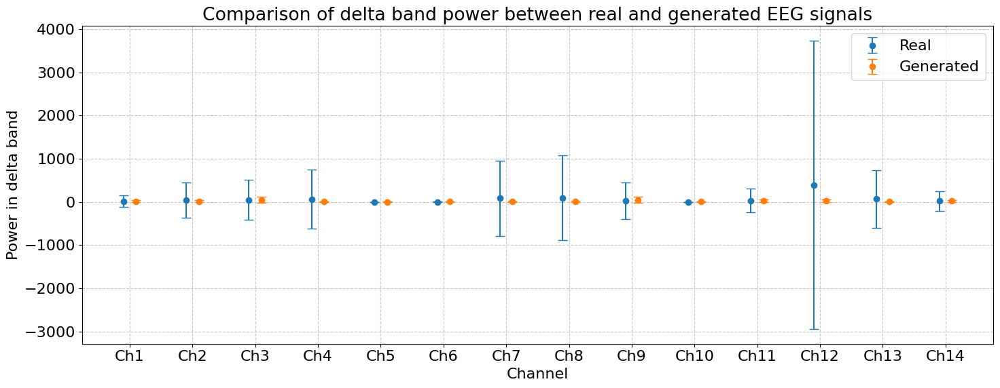

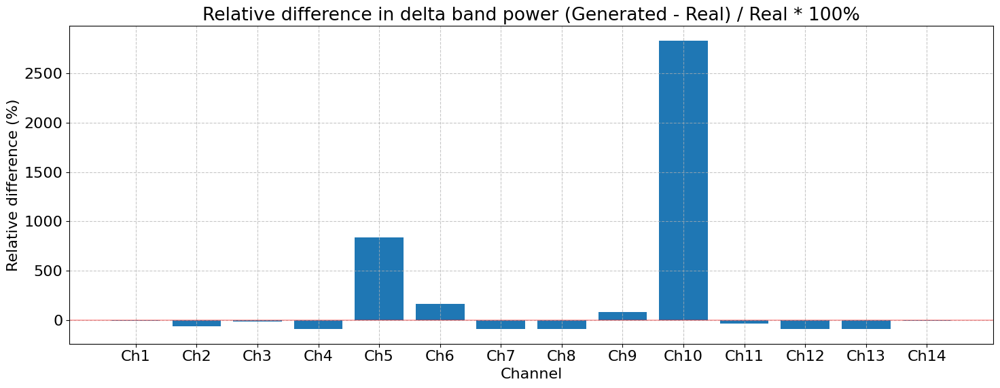

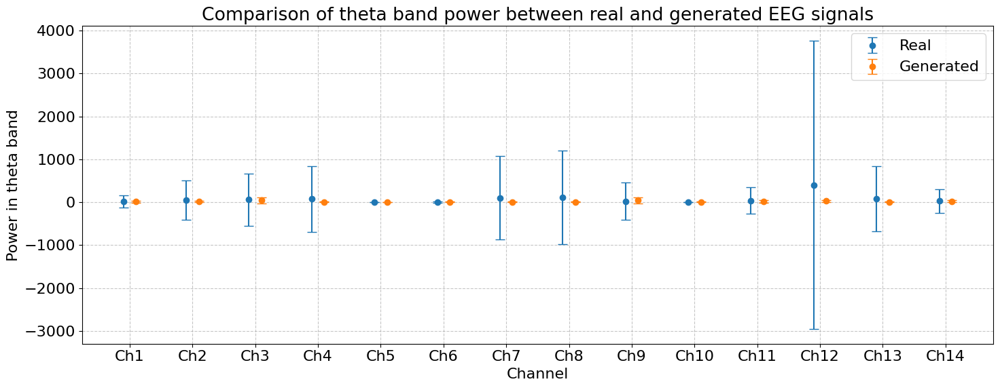

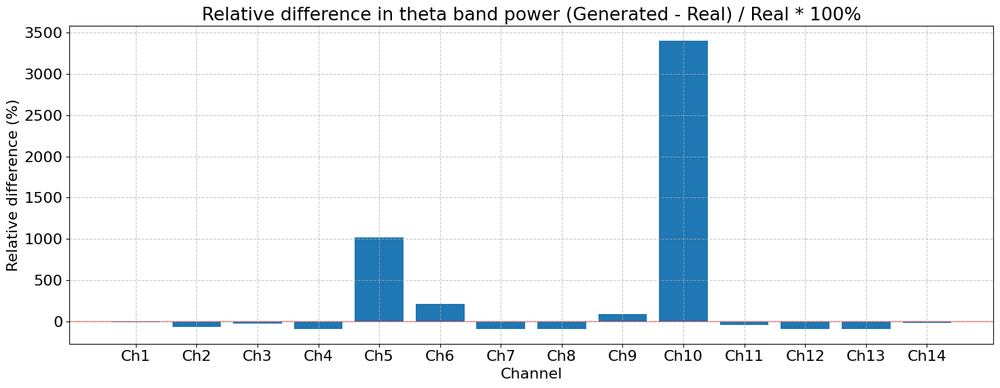

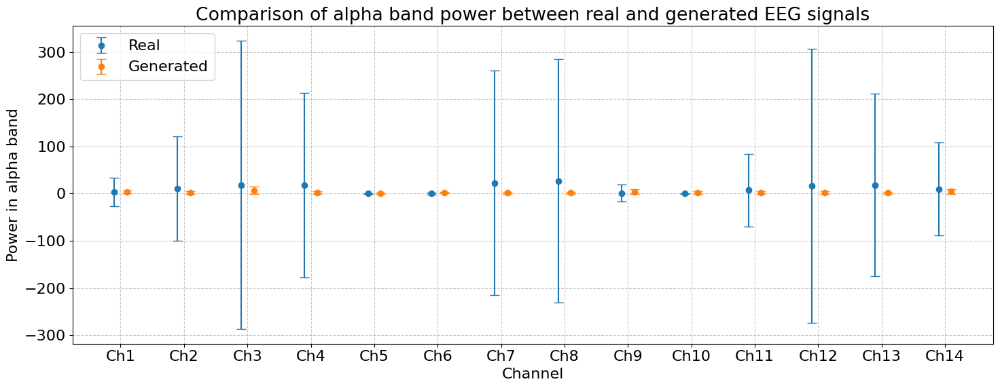

...

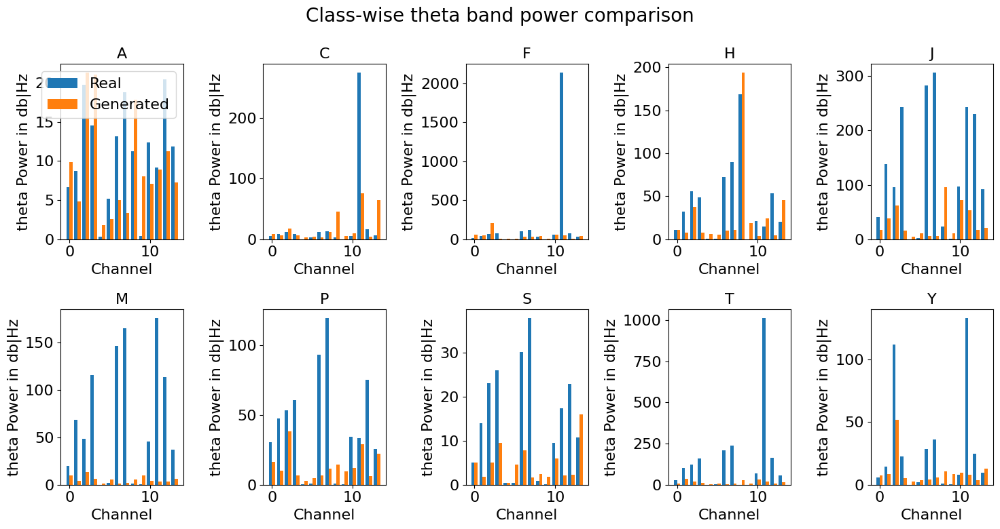

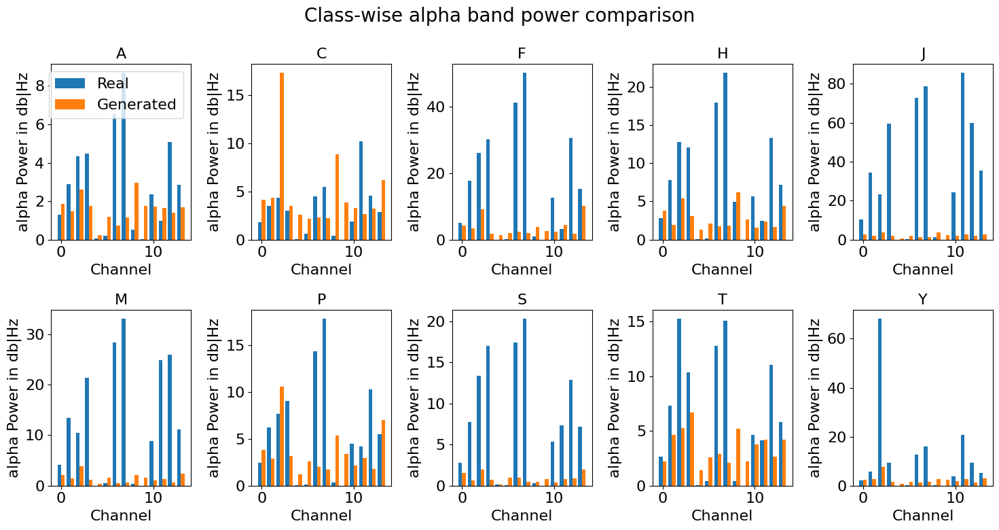

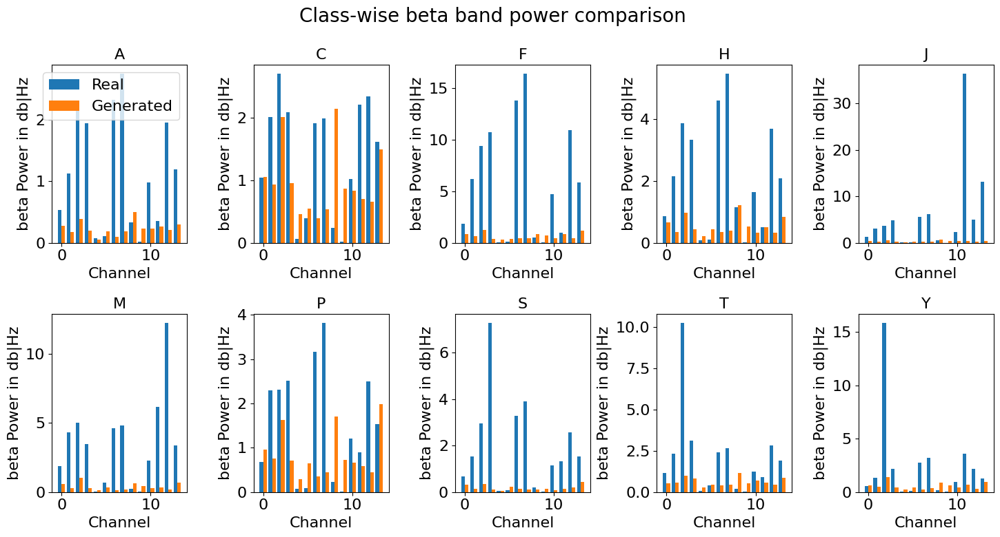

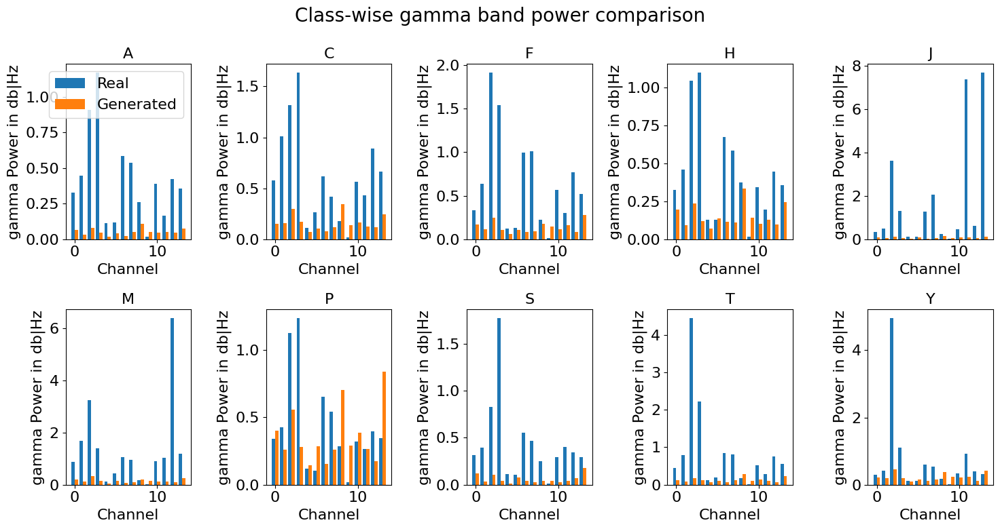

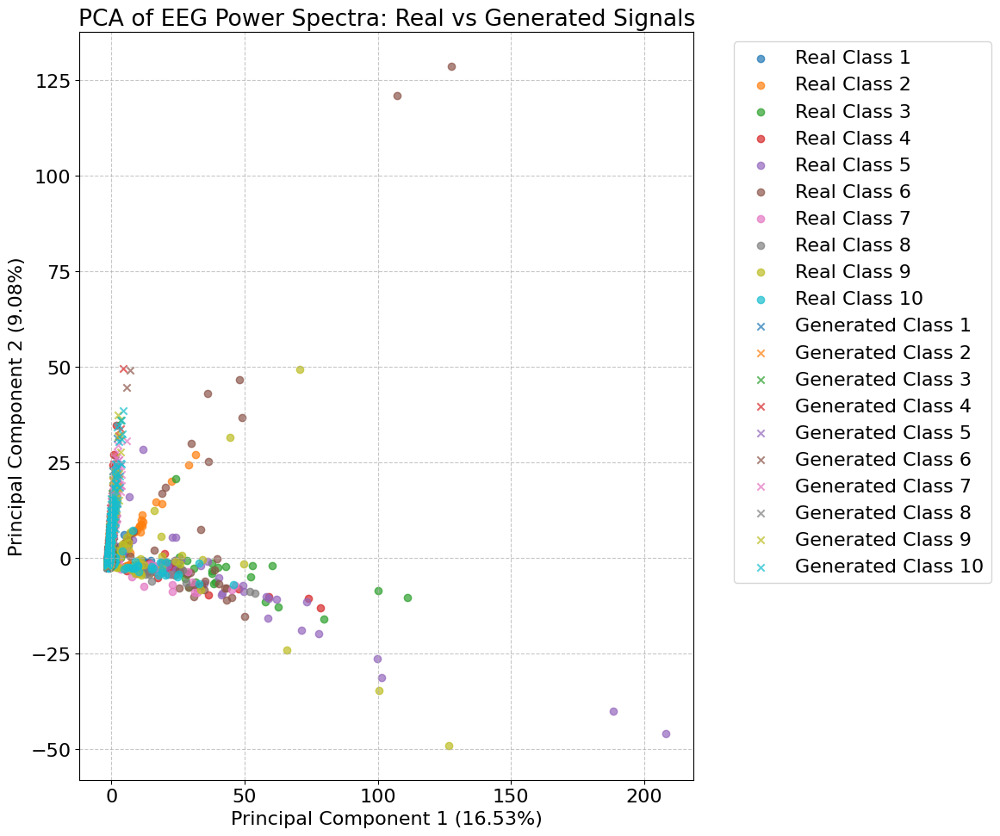

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy.fft import fft, fftfreq
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

def load_eeg_data(file_path):
    """
    Load the EEG data from numpy files
    
    Args:
        file_path: Path to the numpy file containing EEG data
        
    Returns:
        data: Loaded numpy array
    """
    return np.load(file_path)

def compute_power_spectrum(eeg_data, fs=100):
    """
    Compute power spectrum for each channel in the EEG data
    
    Args:
        eeg_data: Numpy array of shape (n_samples, n_channels, n_timepoints)
        fs: Sampling frequency in Hz (default: 100 Hz)
        
    Returns:
        power_spectra: Power spectra for each channel and sample
        frequencies: Frequency bins
    """
    eeg_data=np.transpose(eeg_data, (0, 2, 1))
    n_samples, n_channels, n_timepoints = eeg_data.shape
    
    # Calculate the frequencies
    frequencies = fftfreq(n_timepoints, 1.0/fs)
    # Take only positive frequencies
    pos_freq_idx = np.where(frequencies >= 0)
    frequencies = frequencies[pos_freq_idx]
    
    # Initialize power spectra array
    power_spectra = np.zeros((n_samples, n_channels, len(frequencies)))
    
    # Compute power spectrum for each sample and channel
    for i in range(n_samples):
        for j in range(n_channels):
            # Apply Hamming window
            windowed_signal = eeg_data[i, j, :] * signal.windows.hamming(n_timepoints)
            
            # Compute FFT
            signal_fft = fft(windowed_signal)
            
            # Take absolute value and square to get power
            power = np.abs(signal_fft) ** 2
            
            # Take only positive frequencies
            power_spectra[i, j, :] = power[pos_freq_idx]
    
    return power_spectra, frequencies

def compute_band_power(power_spectra, frequencies, bands):
    """
    Compute power in specified frequency bands
    
    Args:
        power_spectra: Power spectra array (n_samples, n_channels, n_frequencies)
        frequencies: Frequency bins
        bands: Dictionary of frequency bands {band_name: (low_freq, high_freq)}
        
    Returns:
        band_powers: Dictionary of band powers {band_name: powers}
    """
    n_samples, n_channels, _ = power_spectra.shape
    band_powers = {}
    
    for band_name, (low_freq, high_freq) in bands.items():
        # Find indices of frequencies within the band
        band_idx = np.where((frequencies >= low_freq) & (frequencies <= high_freq))[0]
        
        if len(band_idx) == 0:
            continue
            
        # Initialize band power array
        band_power = np.zeros((n_samples, n_channels))
        
        # Sum power across the band for each sample and channel
        for i in range(n_samples):
            for j in range(n_channels):
                band_power[i, j] = np.sum(power_spectra[i, j, band_idx])
        
        band_powers[band_name] = band_power
    
    return band_powers

def analyze_power_differences(real_powers, generated_powers, bands, class_labels=None):
    """
    Analyze differences in power between real and generated EEG signals
    
    Args:
        real_powers: Dictionary of band powers for real signals
        generated_powers: Dictionary of band powers for generated signals
        bands: Dictionary of frequency bands
        class_labels: List of class labels
        
    Returns:
        stats: Dictionary of statistics
    """
    stats = {}
    
    for band_name in bands.keys():
        if band_name not in real_powers or band_name not in generated_powers:
            continue
            
        real_band_power = real_powers[band_name]
        generated_band_power = generated_powers[band_name]
        
        # Compute mean power for each channel
        mean_real = np.mean(real_band_power, axis=0)
        mean_generated = np.mean(generated_band_power, axis=0)
        
        # Compute standard deviation for each channel
        std_real = np.std(real_band_power, axis=0)
        std_generated = np.std(generated_band_power, axis=0)
        
        # Compute relative difference
        rel_diff = (mean_generated - mean_real) / mean_real * 100
        
        stats[band_name] = {
            'mean_real': mean_real,
            'mean_generated': mean_generated,
            'std_real': std_real,
            'std_generated': std_generated,
            'relative_difference_percent': rel_diff
        }
    
    return stats

def visualize_power_comparison(real_data, generated_data, bands, class_labels=None, n_classes=10):
    """
    Visualize power comparison between real and generated EEG signals
    
    Args:
        real_data: Real EEG data
        generated_data: Generated EEG data
        bands: Dictionary of frequency bands
        class_labels: List of class labels
        n_classes: Number of classes
    """
    # Compute power spectra
    fs = 128  # Assuming 100 Hz sampling rate
    real_power_spectra, frequencies = compute_power_spectrum(real_data, fs)
    generated_power_spectra, _ = compute_power_spectrum(generated_data, fs)
    
    # Compute band powers
    real_band_powers = compute_band_power(real_power_spectra, frequencies, bands)
    generated_band_powers = compute_band_power(generated_power_spectra, frequencies, bands)
    
    # Analyze power differences
    stats = analyze_power_differences(real_band_powers, generated_band_powers, bands, class_labels)
    
    # Plot band power comparison for each band
    for band_name, band_stats in stats.items():
        plt.figure(figsize=(15, 6))
        
        # Number of channels
        n_channels = len(band_stats['mean_real'])
        channels = np.arange(n_channels)
        
        # Plot mean power with error bars
        plt.errorbar(channels - 0.1, band_stats['mean_real'], yerr=band_stats['std_real'], 
                     fmt='o', label='Real', capsize=5)
        plt.errorbar(channels + 0.1, band_stats['mean_generated'], yerr=band_stats['std_generated'], 
                     fmt='o', label='Generated', capsize=5)
        
        plt.xlabel('Channel')
        plt.ylabel(f'Power in {band_name} band')
        plt.title(f'Comparison of {band_name} band power between real and generated EEG signals')
        plt.xticks(channels, [f'Ch{i+1}' for i in channels])
        plt.legend()
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.tight_layout()
        
        # Plot relative difference
        plt.figure(figsize=(15, 6))
        plt.bar(channels, band_stats['relative_difference_percent'])
        plt.axhline(y=0, color='r', linestyle='-', alpha=0.3)
        plt.xlabel('Channel')
        plt.ylabel('Relative difference (%)')
        plt.title(f'Relative difference in {band_name} band power (Generated - Real) / Real * 100%')
        plt.xticks(channels, [f'Ch{i+1}' for i in channels])
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.tight_layout()
    
    # Class-wise analysis if class information is available
    if class_labels is not None or n_classes > 0:
        samples_per_class = len(real_data) // n_classes
        
        for band_name in bands.keys():
            if band_name not in real_band_powers or band_name not in generated_band_powers:
                continue
                
            plt.figure(figsize=(15, 8))
            
            for c in range(n_classes):
                class_start = c * samples_per_class
                class_end = (c + 1) * samples_per_class
                
                real_class_power = np.mean(real_band_powers[band_name][class_start:class_end], axis=0)
                generated_class_power = np.mean(generated_band_powers[band_name][class_start:class_end], axis=0)
                
                plt.subplot(2, 5, c+1)
                plt.bar(np.arange(len(real_class_power)) - 0.2, real_class_power, width=0.4, label='Real')
                plt.bar(np.arange(len(generated_class_power)) + 0.2, generated_class_power, width=0.4, label='Generated')
                
                class_name = class_labels[c] if class_labels is not None else f'Class {c+1}'
                plt.title(f'{class_name}',fontsize=16)
                plt.xlabel('Channel',fontsize=16)
                plt.ylabel(f'{band_name} Power in db|Hz',fontsize=16)
                
                if c == 0:
                    plt.legend()
            
            plt.suptitle(f'Class-wise {band_name} band power comparison',fontsize=20)
            plt.tight_layout()

def pca_analysis(real_data, generated_data, n_components=2, n_classes=10):
    """
    Perform PCA analysis on power spectra of real and generated EEG signals
    
    Args:
        real_data: Real EEG data
        generated_data: Generated EEG data
        n_components: Number of PCA components
        n_classes: Number of classes
    """
    # Compute power spectra
    fs = 100  # Assuming 100 Hz sampling rate
    real_power_spectra, _ = compute_power_spectrum(real_data, fs)
    generated_power_spectra, _ = compute_power_spectrum(generated_data, fs)
    
    # Reshape to 2D: (n_samples, n_channels * n_frequencies)
    n_samples_real, n_channels, n_frequencies = real_power_spectra.shape
    n_samples_generated = generated_power_spectra.shape[0]
    
    real_2d = real_power_spectra.reshape(n_samples_real, -1)
    generated_2d = generated_power_spectra.reshape(n_samples_generated, -1)
    
    # Combine data for PCA
    combined_data = np.vstack((real_2d, generated_2d))
    
    # Standardize the data
    scaler = StandardScaler()
    combined_data_scaled = scaler.fit_transform(combined_data)
    
    # Apply PCA
    pca = PCA(n_components=n_components)
    principal_components = pca.fit_transform(combined_data_scaled)
    
    # Split back into real and generated
    pc_real = principal_components[:n_samples_real]
    pc_generated = principal_components[n_samples_real:]
    
    # Create class labels
    samples_per_class = n_samples_real // n_classes
    class_labels = np.repeat(np.arange(n_classes), samples_per_class)
    
    # Plot PCA results
    plt.figure(figsize=(12, 10))
    
    # Plot real data
    for c in range(n_classes):
        class_idx = np.where(class_labels == c)[0]
        plt.scatter(pc_real[class_idx, 0], pc_real[class_idx, 1], 
                   label=f'Real Class {c+1}', alpha=0.7, marker='o')
    
    # Plot generated data
    for c in range(n_classes):
        class_idx = np.where(class_labels == c)[0]
        plt.scatter(pc_generated[class_idx, 0], pc_generated[class_idx, 1], 
                   label=f'Generated Class {c+1}', alpha=0.7, marker='x')
    
    plt.xlabel(f'Principal Component 1 ({pca.explained_variance_ratio_[0]:.2%})')
    plt.ylabel(f'Principal Component 2 ({pca.explained_variance_ratio_[1]:.2%})')
    plt.title('PCA of EEG Power Spectra: Real vs Generated Signals')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()

def main():
    """
    Main function to run the power series analysis
    
    Args:
        real_data_path: Path to real EEG data
        generated_data_path: Path to generated EEG data
    """
    # Load data
    real_data = squeezed_data1
    generated_data = generated_signals_test
    
    print(f"Real data shape: {real_data.shape}")
    print(f"Generated data shape: {generated_data.shape}")
    
    # Define frequency bands (in Hz)
    bands = {
        'delta': (0.5, 4),
        'theta': (4, 8),
        'alpha': (8, 13),
        'beta': (13, 30),
        'gamma': (30, 50)
    }
    
    # Define alphabet classes (assuming 10 alphabets)
    class_labels = ['A', 'C', 'F', 'H', 'J', 'M', 'P', 'S', 'T', 'Y']
    
    # Visualize power comparison
    visualize_power_comparison(real_data, generated_data, bands, class_labels, n_classes=10)
    
    # Perform PCA analysis
    pca_analysis(real_data, generated_data, n_components=2, n_classes=10)
    
    # Show all plots
    plt.show()
main()
# Example usage:
# main('real_eeg_data.npy', 'generated_eeg_data.npy')

In [4]:
squeezed_data.shape

(40000, 32, 14)

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy.fft import fft, fftfreq
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

def load_eeg_data(file_path):
    """
    Load the EEG data from numpy files
    
    Args:
        file_path: Path to the numpy file containing EEG data
        
    Returns:
        data: Loaded numpy array
    """
    return np.load(file_path)

def compute_power_spectrum(eeg_data, fs=100):
    """
    Compute power spectrum for each channel in the EEG data
    
    Args:
        eeg_data: Numpy array of shape (n_samples, n_channels, n_timepoints)
        fs: Sampling frequency in Hz (default: 100 Hz)
        
    Returns:
        power_spectra: Power spectra for each channel and sample
        frequencies: Frequency bins
    """
    eeg_data=np.transpose(eeg_data, (0, 2, 1))
    n_samples, n_channels, n_timepoints = eeg_data.shape
    
    # Calculate the frequencies
    frequencies = fftfreq(n_timepoints, 1.0/fs)
    # Take only positive frequencies
    pos_freq_idx = np.where(frequencies >= 0)
    frequencies = frequencies[pos_freq_idx]
    
    # Initialize power spectra array
    power_spectra = np.zeros((n_samples, n_channels, len(frequencies)))
    
    # Compute power spectrum for each sample and channel
    for i in range(n_samples):
        for j in range(n_channels):
            # Apply Hamming window
            windowed_signal = eeg_data[i, j, :] * signal.windows.hamming(n_timepoints)
            
            # Compute FFT
            signal_fft = fft(windowed_signal)
            
            # Take absolute value and square to get power
            power = np.abs(signal_fft) ** 2
            
            # Take only positive frequencies
            power_spectra[i, j, :] = power[pos_freq_idx]
    
    return power_spectra, frequencies

def compute_band_power(power_spectra, frequencies, bands):
    """
    Compute power in specified frequency bands
    
    Args:
        power_spectra: Power spectra array (n_samples, n_channels, n_frequencies)
        frequencies: Frequency bins
        bands: Dictionary of frequency bands {band_name: (low_freq, high_freq)}
        
    Returns:
        band_powers: Dictionary of band powers {band_name: powers}
    """
    n_samples, n_channels, _ = power_spectra.shape
    band_powers = {}
    
    for band_name, (low_freq, high_freq) in bands.items():
        # Find indices of frequencies within the band
        band_idx = np.where((frequencies >= low_freq) & (frequencies <= high_freq))[0]
        
        if len(band_idx) == 0:
            continue
            
        # Initialize band power array
        band_power = np.zeros((n_samples, n_channels))
        
        # Sum power across the band for each sample and channel
        for i in range(n_samples):
            for j in range(n_channels):
                band_power[i, j] = np.sum(power_spectra[i, j, band_idx])
        
        band_powers[band_name] = band_power
    
    return band_powers

def analyze_power_differences(real_powers, generated_powers, bands, class_labels=None):
    """
    Analyze differences in power between real and generated EEG signals
    
    Args:
        real_powers: Dictionary of band powers for real signals
        generated_powers: Dictionary of band powers for generated signals
        bands: Dictionary of frequency bands
        class_labels: List of class labels
        
    Returns:
        stats: Dictionary of statistics
    """
    stats = {}
    
    for band_name in bands.keys():
        if band_name not in real_powers or band_name not in generated_powers:
            continue
            
        real_band_power = real_powers[band_name]
        generated_band_power = generated_powers[band_name]
        
        # Compute mean power for each channel
        mean_real = np.mean(real_band_power, axis=0)
        mean_generated = np.mean(generated_band_power, axis=0)
        
        # Compute standard deviation for each channel
        std_real = np.std(real_band_power, axis=0)
        std_generated = np.std(generated_band_power, axis=0)
        
        # Compute relative difference
        rel_diff = (mean_generated - mean_real) / mean_real * 100
        
        stats[band_name] = {
            'mean_real': mean_real,
            'mean_generated': mean_generated,
            'std_real': std_real,
            'std_generated': std_generated,
            'relative_difference_percent': rel_diff
        }
    
    return stats

In [6]:
! pip install mne

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
   ---------------------------------------- 0.0/7.4 MB ? eta -:--:--
   ---------------------------------------- 7.4/7.4 MB 57.0 MB/s eta 0:00:00



[notice] A new release of pip is available: 25.0.1 -> 25.1
[notice] To update, run: python.exe -m pip install --upgrade pip


['__add__', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__iadd__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__slotnames__', '__str__', '__subclasshook__', '__weakref__', '_get_ch_pos', '_get_dig_names', 'add_estimated_fiducials', 'add_mni_fiducials', 'apply_trans', 'ch_names', 'copy', 'dig', 'get_positions', 'plot', 'remove_fiducials', 'rename_channels', 'save']
['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 

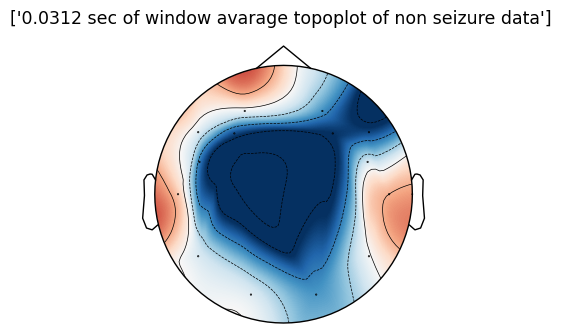

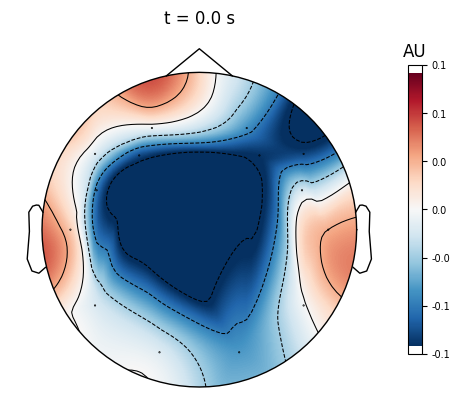

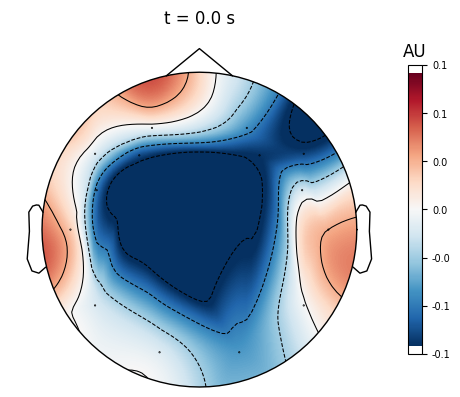

In [22]:
import numpy as np
import mne

data =np.mean(squeezed_data[300:400], axis=0)
ch_names = ['AF3', 'F7', 'F3', 'FC5', 'T7', 'P7', 'O1', 'O2',
            'P8', 'T8', 'FC6', 'F4', 'F8', 'AF4']
sfreq = 128  

info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')
montage = mne.channels.make_standard_montage('biosemi64')
#montage = mne.channels.make_standard_montage('standard_1020')
#montage = montage.copy().pick_channels(ch_names)


print(dir(montage))
print((montage.ch_names))
info.set_montage(montage)

# Get signal at time index 10
signal_at_t10 = data[10]  # shape: (14,)
evoked_data = signal_at_t10[:, np.newaxis]  # shape: (14, 1)
extrapolations = ["0.0312 sec of window avarage topoplot of non seizure data"]
# Create EvokedArray for time index 10
evoked = mne.EvokedArray(evoked_data, info, tmin=0.0)



fig, ax = plt.subplots(ncols=1, figsize=(4, 4), gridspec_kw=dict(top=0.9),
                       sharex=True, sharey=True)
mne.viz.plot_topomap(evoked.data[:, 0], evoked.info, axes=ax,
                     show=False)
ax.set_title("%s " % ( extrapolations), fontsize=12.5)

# Plot topomap
evoked.plot_topomap(times=0.0, scalings=1, time_format='t = %s s', cmap='RdBu_r', size=3)

['__add__', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__iadd__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__slotnames__', '__str__', '__subclasshook__', '__weakref__', '_get_ch_pos', '_get_dig_names', 'add_estimated_fiducials', 'add_mni_fiducials', 'apply_trans', 'ch_names', 'copy', 'dig', 'get_positions', 'plot', 'remove_fiducials', 'rename_channels', 'save']
['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 

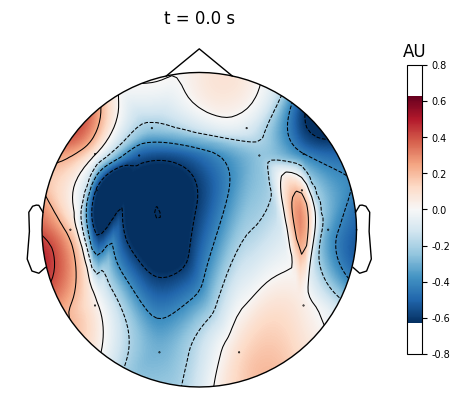

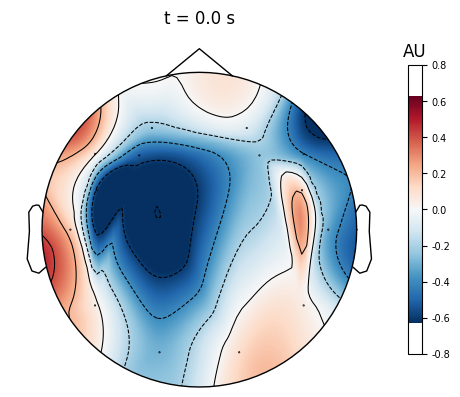

In [10]:
import numpy as np
import mne

data =np.mean(generated_signals[300:400], axis=0)
ch_names = ['AF3', 'F7', 'F3', 'FC5', 'T7', 'P7', 'O1', 'O2',
            'P8', 'T8', 'FC6', 'F4', 'F8', 'AF4']
sfreq = 128  

info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')
montage = mne.channels.make_standard_montage('biosemi64')
#montage = mne.channels.make_standard_montage('standard_1020')
#montage = montage.copy().pick_channels(ch_names)
print(dir(montage))
print((montage.ch_names))
info.set_montage(montage)

# Get signal at time index 10
signal_at_t10 = data[10]  # shape: (14,)
evoked_data = signal_at_t10[:, np.newaxis]  # shape: (14, 1)

# Create EvokedArray for time index 10
evoked = mne.EvokedArray(evoked_data, info, tmin=0.0)

# Plot topomap
evoked.plot_topomap(times=0.0, scalings=1, time_format='t = %s s', cmap='RdBu_r', size=3)

In [42]:
import numpy as np
import mne
import matplotlib.pyplot as plt

# Simulated `squeezed_data` — replace with your actual data
# squeezed_data shape: (n_times, n_channels)
# Example shape: (500, 14)
# For demonstration, let's assume squeezed_data exists
data = np.mean(squeezed_data[600:800], axis=0)  # shape: (14,)

ch_names = ['AF3', 'F7', 'F3', 'FC5', 'T7', 'P7', 'O1', 'O2',
            'P8', 'T8', 'FC6', 'F4', 'F8', 'AF4']
sfreq = 128  # Hz

info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')
montage = mne.channels.make_standard_montage('biosemi64')
info.set_montage(montage)

# Convert your data to RawArray for filtering
raw_data = np.mean(squeezed_data[0:40],axis=0).T  # shape: (14, 100)
raw = mne.io.RawArray(raw_data, info)

# Define frequency bands
bands = {
    'Delta (0.5–4 Hz)': (0.5, 4),
    'Theta (4–8 Hz)': (4, 8),
    'Alpha (8–13 Hz)': (8, 13),
    'Beta (13–30 Hz)': (13, 30),
    'Gamma (30–45 Hz)': (30, 45),
}
fs = 128  # Assuming 100 Hz sampling rate
real_power_spectra, frequencies = compute_power_spectrum(squeezed_data1, fs)
generated_power_spectra, _ = compute_power_spectrum(generated_signals_test, fs)
    
# Compute band powers
real_band_powers = compute_band_power(real_power_spectra, frequencies, bands)
generated_band_powers = compute_band_power(generated_power_spectra, frequencies, bands)
print(generated_band_powers.keys())

real_keys=real_band_powers.keys()


Creating RawArray with float64 data, n_channels=14, n_times=32
    Range : 0 ... 31 =      0.000 ...     0.242 secs
Ready.


dict_keys(['Delta (0.5–4 Hz)', 'Theta (4–8 Hz)', 'Alpha (8–13 Hz)', 'Beta (13–30 Hz)', 'Gamma (30–45 Hz)'])


In [44]:
real_band_powers['Delta (0.5–4 Hz)'].shape

(5400, 14)

C:\Users\Admin\AppData\Local\Temp\ipykernel_19504\1266851042.py:4: RuntimeWarning: filter_length (845) is longer than the signal (32), distortion is likely. Reduce filter length or filter a longer signal.
  filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)


(14, 1)


C:\Users\Admin\AppData\Local\Temp\ipykernel_19504\1266851042.py:4: RuntimeWarning: filter_length (213) is longer than the signal (32), distortion is likely. Reduce filter length or filter a longer signal.
  filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)


(14, 1)


C:\Users\Admin\AppData\Local\Temp\ipykernel_19504\1266851042.py:4: RuntimeWarning: filter_length (213) is longer than the signal (32), distortion is likely. Reduce filter length or filter a longer signal.
  filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)
C:\Users\Admin\AppData\Local\Temp\ipykernel_19504\1266851042.py:4: RuntimeWarning: filter_length (131) is longer than the signal (32), distortion is likely. Reduce filter length or filter a longer signal.
  filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)


(14, 1)
(14, 1)


C:\Users\Admin\AppData\Local\Temp\ipykernel_19504\1266851042.py:4: RuntimeWarning: filter_length (57) is longer than the signal (32), distortion is likely. Reduce filter length or filter a longer signal.
  filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)


(14, 1)


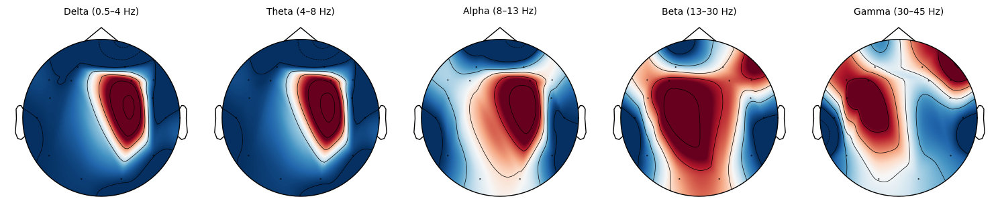

In [52]:
fig, axes = plt.subplots(1, 5, figsize=(15, 4))
for ax, (band, (fmin, fmax)) in zip(axes, bands.items()):
    # Bandpass filter
    filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)
    
    # Compute average signal across time
    avg_data = np.mean(filtered.get_data(), axis=1)[:, np.newaxis]  # shape: (14, 1)
    avg_data=np.mean(real_band_powers[band][540:2*540], axis=0)[:, np.newaxis]  # shape: (14, 1)
    # Create Evoked object
    evoked = mne.EvokedArray(avg_data, info, tmin=0)
    print(evoked.data.shape)
    # Plot topomap
    mne.viz.plot_topomap(
    evoked.data[:, 0], evoked.info, axes=ax,
    show=False, cmap='RdBu_r',
    )

    ax.set_title(band, fontsize=10)

plt.tight_layout()
plt.show()


C:\Users\Admin\AppData\Local\Temp\ipykernel_19504\2376606022.py:4: RuntimeWarning: filter_length (845) is longer than the signal (32), distortion is likely. Reduce filter length or filter a longer signal.
  filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)


(14, 1)


C:\Users\Admin\AppData\Local\Temp\ipykernel_19504\2376606022.py:4: RuntimeWarning: filter_length (213) is longer than the signal (32), distortion is likely. Reduce filter length or filter a longer signal.
  filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)
C:\Users\Admin\AppData\Local\Temp\ipykernel_19504\2376606022.py:4: RuntimeWarning: filter_length (213) is longer than the signal (32), distortion is likely. Reduce filter length or filter a longer signal.
  filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)
C:\Users\Admin\AppData\Local\Temp\ipykernel_19504\2376606022.py:4: RuntimeWarning: filter_length (131) is longer than the signal (32), distortion is likely. Reduce filter length or filter a longer signal.
  filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)
C:\Users\Admin\AppData\Local\Temp\ipykernel_19504\2376606022.py:4: RuntimeWarning: filter_length (57) is longer than the signal (32), distortion is 

(14, 1)
(14, 1)
(14, 1)
(14, 1)


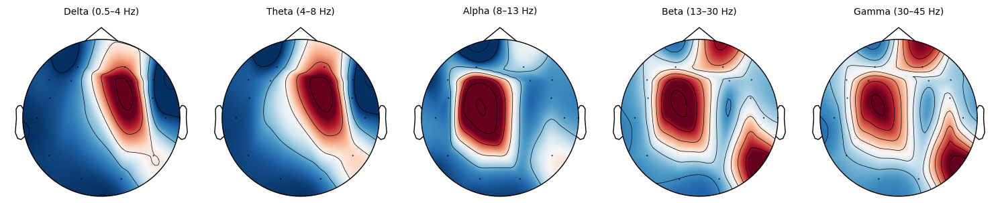

: 

In [ ]:
fig, axes = plt.subplots(1, 5, figsize=(15, 4))
for ax, (band, (fmin, fmax)) in zip(axes, bands.items()):
    # Bandpass filter
    filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)
    
    # Compute average signal across time
    #avg_data = np.mean(filtered.get_data(), axis=1)[:, np.newaxis]  # shape: (14, 1)
    avg_data=np.mean(generated_band_powers[band][540:2*540], axis=0)[:, np.newaxis]  # shape: (14, 1)
    # Create Evoked object
    evoked = mne.EvokedArray(avg_data, info, tmin=0)
    print(evoked.data.shape)
    # Plot topomap
    mne.viz.plot_topomap(
    evoked.data[:, 0], evoked.info, axes=ax,
    show=False, cmap='RdBu_r',
    )

    ax.set_title(band, fontsize=10)

plt.tight_layout()
plt.show()


In [17]:
print(generated_band_powers['Delta (0.5–4 Hz)'].shape)

(40000, 14)


Creating RawArray with float64 data, n_channels=14, n_times=32
    Range : 0 ... 31 =      0.000 ...     0.242 secs
Ready.


C:\Users\Admin\AppData\Local\Temp\ipykernel_14620\1288028973.py:37: RuntimeWarning: filter_length (845) is longer than the signal (32), distortion is likely. Reduce filter length or filter a longer signal.
  filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)
C:\Users\Admin\AppData\Local\Temp\ipykernel_14620\1288028973.py:37: RuntimeWarning: filter_length (213) is longer than the signal (32), distortion is likely. Reduce filter length or filter a longer signal.
  filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)
C:\Users\Admin\AppData\Local\Temp\ipykernel_14620\1288028973.py:37: RuntimeWarning: filter_length (213) is longer than the signal (32), distortion is likely. Reduce filter length or filter a longer signal.
  filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)
C:\Users\Admin\AppData\Local\Temp\ipykernel_14620\1288028973.py:37: RuntimeWarning: filter_length (131) is longer than the signal (32), distortio

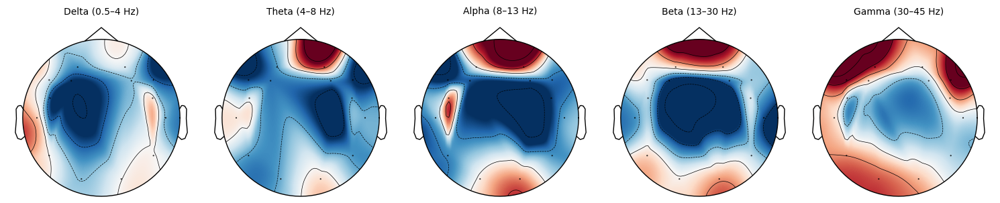

In [42]:
import numpy as np
import mne
import matplotlib.pyplot as plt

# Simulated `squeezed_data` — replace with your actual data
# squeezed_data shape: (n_times, n_channels)
# Example shape: (500, 14)
# For demonstration, let's assume squeezed_data exists
data = np.mean(generated_signals[600:800], axis=0)  # shape: (14,)

ch_names = ['AF3', 'F7', 'F3', 'FC5', 'T7', 'P7', 'O1', 'O2',
            'P8', 'T8', 'FC6', 'F4', 'F8', 'AF4']
sfreq = 128  # Hz

info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')
montage = mne.channels.make_standard_montage('biosemi64')
info.set_montage(montage)

# Convert your data to RawArray for filtering
raw_data = np.mean(generated_signals[0:40],axis=0).T  # shape: (14, 100)

raw = mne.io.RawArray(raw_data, info)

# Define frequency bands
bands = {
    'Delta (0.5–4 Hz)': (0.5, 4),
    'Theta (4–8 Hz)': (4, 8),
    'Alpha (8–13 Hz)': (8, 13),
    'Beta (13–30 Hz)': (13, 30),
    'Gamma (30–45 Hz)': (30, 45),
}

fig, axes = plt.subplots(1, 5, figsize=(15, 4))

for ax, (band, (fmin, fmax)) in zip(axes, bands.items()):
    # Bandpass filter
    filtered = raw.copy().filter(fmin, fmax, fir_design='firwin', verbose=False)
    
    # Compute average signal across time
    avg_data = np.mean(filtered.get_data(), axis=1)[:, np.newaxis]  # shape: (14, 1)
    
    # Create Evoked object
    evoked = mne.EvokedArray(avg_data, info, tmin=0)
    
    # Plot topomap
    mne.viz.plot_topomap(
    evoked.data[:, 0], evoked.info, axes=ax,
    show=False, cmap='RdBu_r',
    )

    ax.set_title(band, fontsize=10)

plt.tight_layout()
plt.show()


In [13]:
! pip install PyWavelets


Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
   ---------------------------------------- 0.0/4.2 MB ? eta -:--:--
   ---------------------------------------- 4.2/4.2 MB 28.0 MB/s eta 0:00:00


Real data shape: (40000, 32, 14)
Generated data shape: (40000, 32, 14)


C:\Users\Admin\AppData\Local\Temp\ipykernel_16812\723963193.py:264: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 0.95])  # Adjust layout to make room for colorbar


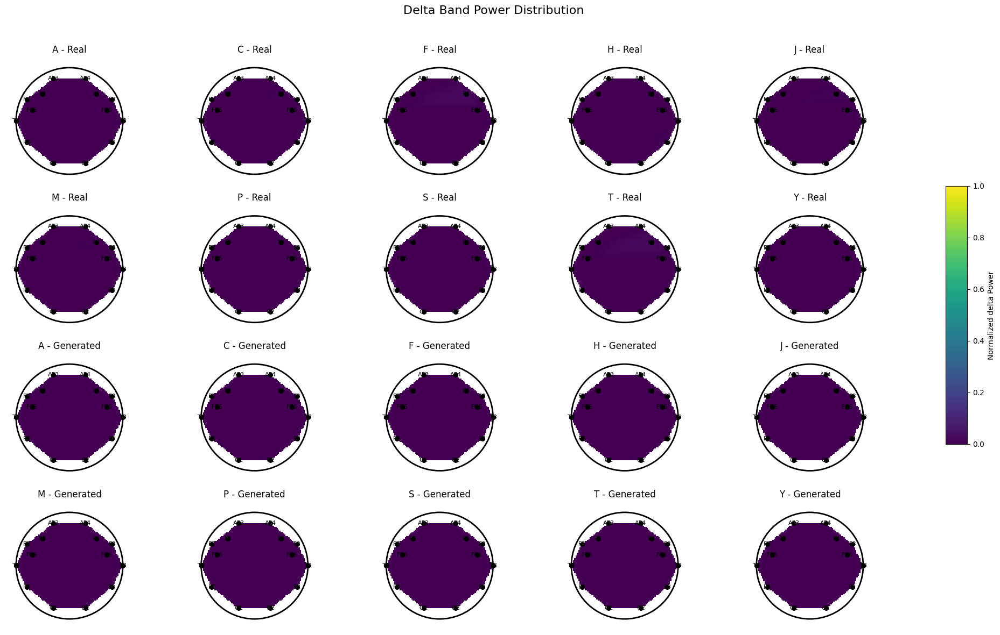

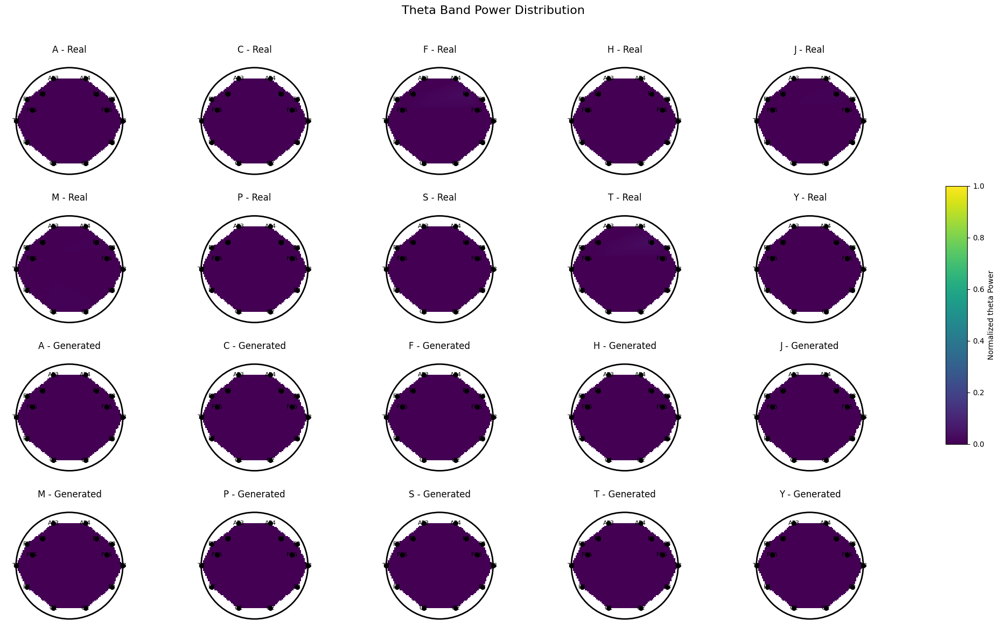

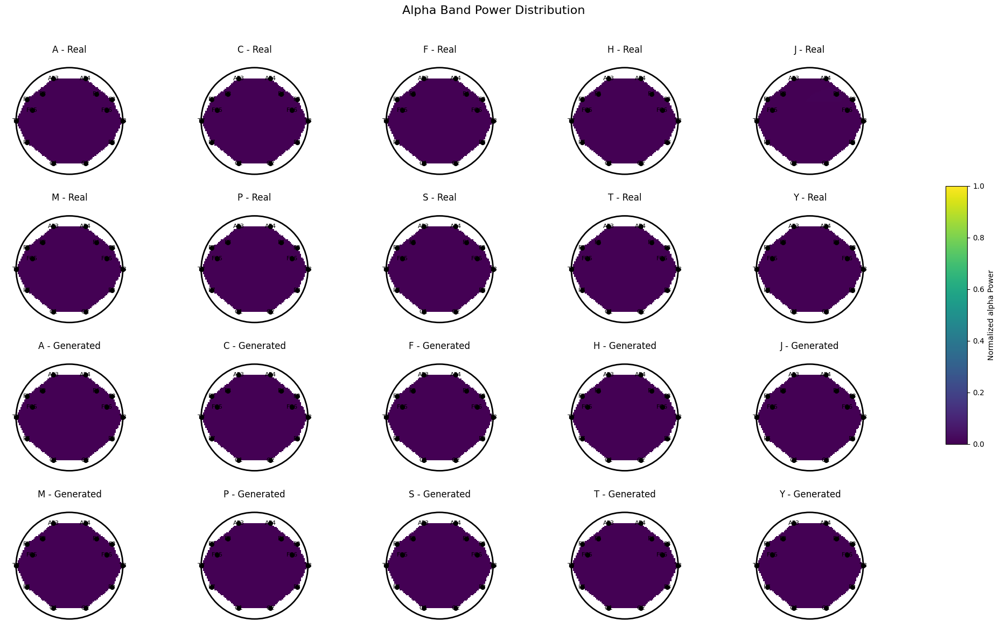

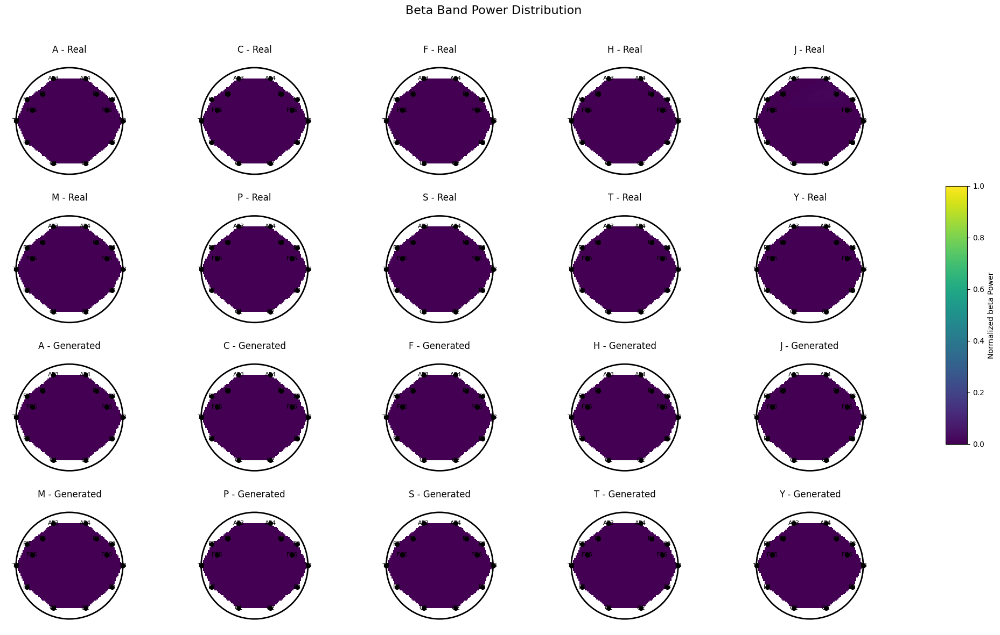

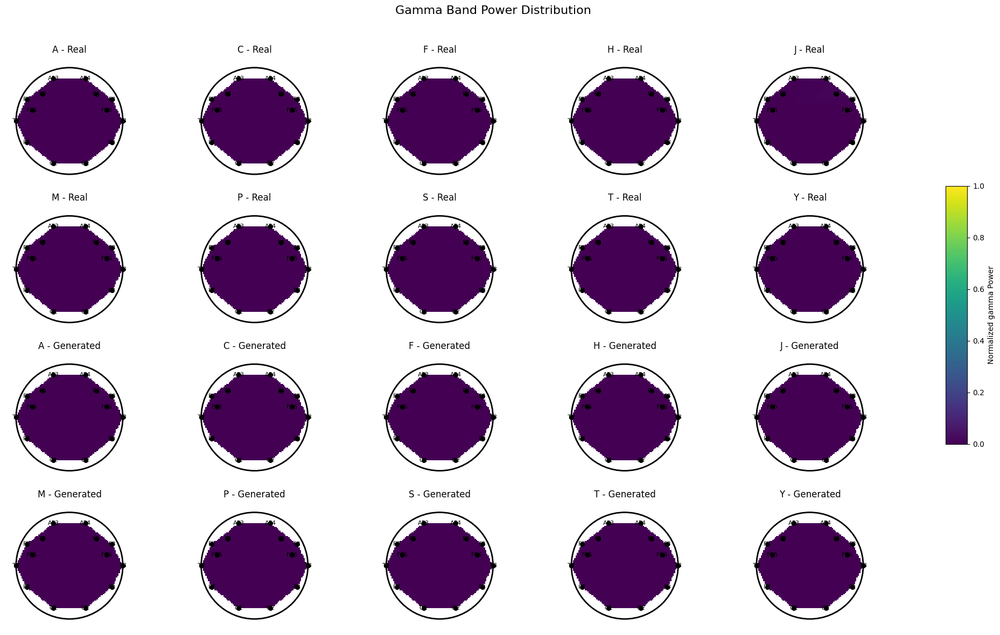

...

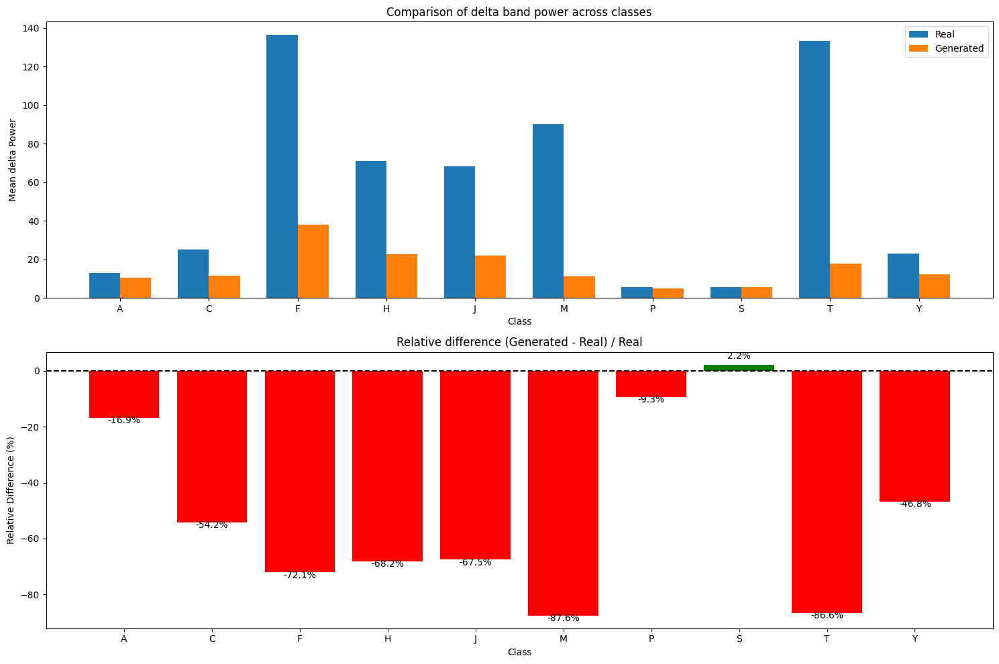

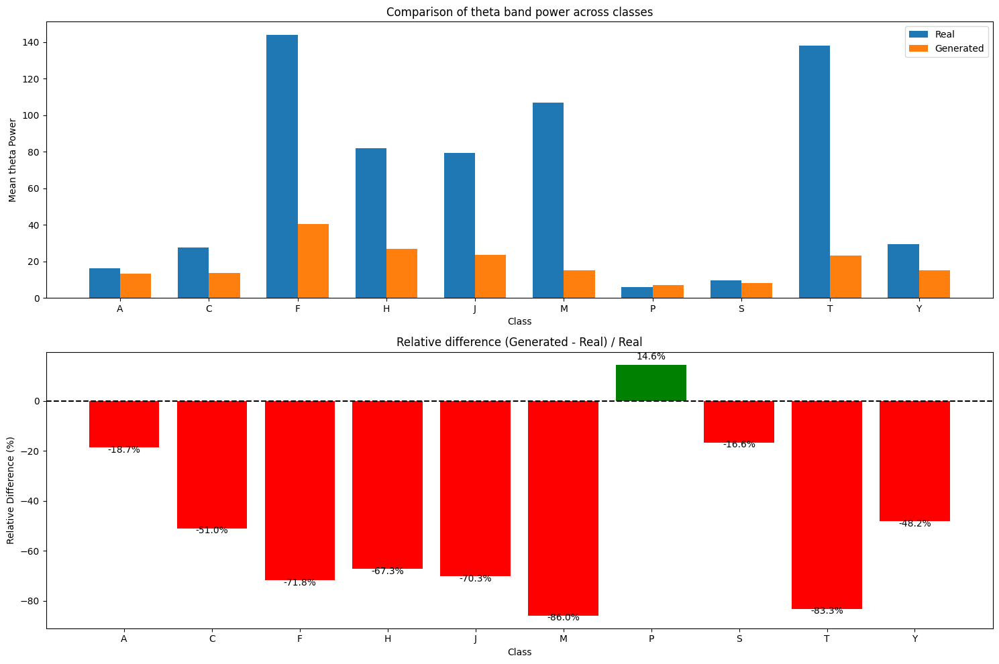

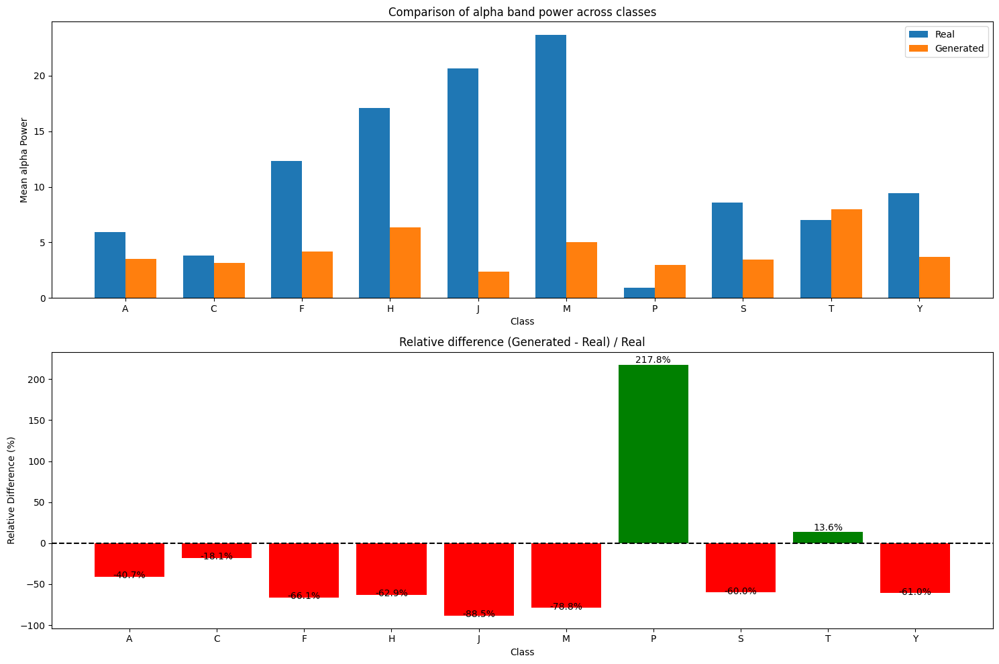

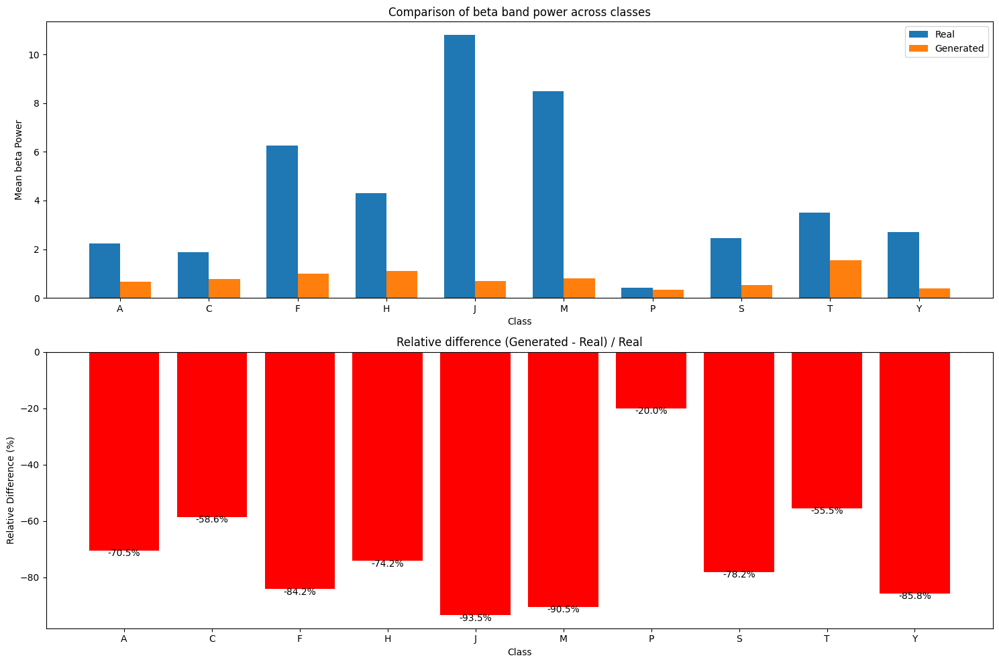

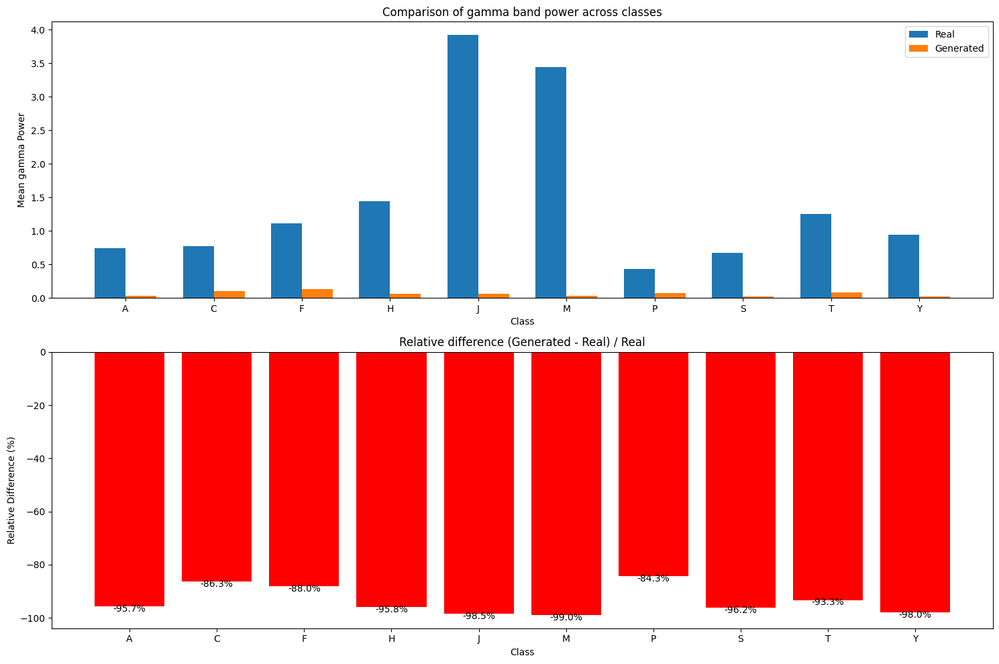

In [24]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy.fft import fft, fftfreq
import pandas as pd
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import Normalize
import matplotlib.cm as cm

def load_eeg_data(file_path):
    """
    Load the EEG data from numpy files
    
    Args:
        file_path: Path to the numpy file containing EEG data
        
    Returns:
        data: Loaded numpy array
    """
    return np.load(file_path)

def compute_power_spectrum(eeg_data, fs=128):
    """
    Compute power spectrum for each channel in the EEG data
    
    Args:
        eeg_data: Numpy array of shape (n_samples, n_timepoints, n_channels)
        fs: Sampling frequency in Hz (default: 128 Hz)
        
    Returns:
        power_spectra: Power spectra for each channel and sample
        frequencies: Frequency bins
    """
    # Transpose to shape (n_samples, n_channels, n_timepoints)
    eeg_data = np.transpose(eeg_data, (0, 2, 1))
    n_samples, n_channels, n_timepoints = eeg_data.shape
    
    # Calculate the frequencies
    frequencies = fftfreq(n_timepoints, 1.0/fs)
    # Take only positive frequencies
    pos_freq_idx = np.where(frequencies >= 0)
    frequencies = frequencies[pos_freq_idx]
    
    # Initialize power spectra array
    power_spectra = np.zeros((n_samples, n_channels, len(frequencies)))
    
    # Compute power spectrum for each sample and channel
    for i in range(n_samples):
        for j in range(n_channels):
            # Apply Hamming window
            windowed_signal = eeg_data[i, j, :] * signal.windows.hamming(n_timepoints)
            
            # Compute FFT
            signal_fft = fft(windowed_signal)
            
            # Take absolute value and square to get power
            power = np.abs(signal_fft) ** 2
            
            # Take only positive frequencies
            power_spectra[i, j, :] = power[pos_freq_idx]
    
    return power_spectra, frequencies

def compute_band_power(power_spectra, frequencies, bands):
    """
    Compute power in specified frequency bands
    
    Args:
        power_spectra: Power spectra array (n_samples, n_channels, n_frequencies)
        frequencies: Frequency bins
        bands: Dictionary of frequency bands {band_name: (low_freq, high_freq)}
        
    Returns:
        band_powers: Dictionary of band powers {band_name: powers}
    """
    n_samples, n_channels, _ = power_spectra.shape
    band_powers = {}
    
    for band_name, (low_freq, high_freq) in bands.items():
        # Find indices of frequencies within the band
        band_idx = np.where((frequencies >= low_freq) & (frequencies <= high_freq))[0]
        
        if len(band_idx) == 0:
            continue
            
        # Initialize band power array
        band_power = np.zeros((n_samples, n_channels))
        
        # Sum power across the band for each sample and channel
        for i in range(n_samples):
            for j in range(n_channels):
                band_power[i, j] = np.sum(power_spectra[i, j, band_idx])
        
        band_powers[band_name] = band_power
    
    return band_powers

def get_emotiv_channel_positions():
    """
    Get the 2D positions of Emotiv EPOC channels for topographic plotting
    
    Returns:
        channel_positions: Dictionary mapping channel names to (x, y) coordinates
    """
    # Emotiv EPOC 14 channels: AF3, F7, F3, FC5, T7, P7, O1, O2, P8, T8, FC6, F4, F8, AF4
    # Approximate positions in a 2D space
    channel_positions = {
        'AF3': (-0.3, 0.8),
        'F7': (-0.8, 0.4),
        'F3': (-0.5, 0.5),
        'FC5': (-0.7, 0.2),
        'T7': (-1.0, 0),
        'P7': (-0.8, -0.4),
        'O1': (-0.3, -0.8),
        'O2': (0.3, -0.8),
        'P8': (0.8, -0.4),
        'T8': (1.0, 0),
        'FC6': (0.7, 0.2),
        'F4': (0.5, 0.5),
        'F8': (0.8, 0.4),
        'AF4': (0.3, 0.8)
    }
    return channel_positions

def create_topomap(data, ax, title=None, vmin=None, vmax=None, colorbar=True):
    """
    Create a topographic map of EEG data
    
    Args:
        data: Channel data to plot (array of length n_channels)
        ax: Matplotlib axis to plot on
        title: Title for the plot
        vmin: Minimum value for color scaling
        vmax: Maximum value for color scaling
        colorbar: Whether to add a colorbar
        
    Returns:
        im: The image object
    """
    channel_positions = get_emotiv_channel_positions()
    channel_names = list(channel_positions.keys())
    
    # Create a grid for interpolation
    grid_resolution = 100
    xi = np.linspace(-1.2, 1.2, grid_resolution)
    yi = np.linspace(-1.2, 1.2, grid_resolution)
    Xi, Yi = np.meshgrid(xi, yi)
    
    # Extract x and y coordinates of channels
    x = np.array([channel_positions[ch][0] for ch in channel_names])
    y = np.array([channel_positions[ch][1] for ch in channel_names])
    
    # Use matplotlib's built-in griddata
    from matplotlib.tri import Triangulation, LinearTriInterpolator
    triang = Triangulation(x, y)
    interpolator = LinearTriInterpolator(triang, data)
    zi = interpolator(Xi, Yi)
    
    # Create a mask for points outside the head circle
    mask = (Xi**2 + Yi**2) > 1.0**2
    zi = np.ma.array(zi, mask=mask)
    
    # Plot the interpolated data
    norm = Normalize(vmin=vmin, vmax=vmax)
    im = ax.pcolormesh(Xi, Yi, zi, shading='auto', norm=norm, cmap='viridis')
    
    # Draw the head outline
    circle = plt.Circle((0, 0), 1, fill=False, linewidth=2, color='black')
    ax.add_patch(circle)
    
    # Mark the electrode positions
    ax.scatter(x, y, s=30, c='k', marker='o')
    
    # Add channel labels
    for i, ch in enumerate(channel_names):
        ax.text(x[i], y[i], ch, ha='center', va='center', fontsize=8)
    
    # Set limits and remove axis
    ax.set_xlim(-1.2, 1.2)
    ax.set_ylim(-1.2, 1.2)
    ax.set_aspect('equal')
    ax.axis('off')
    
    if title:
        ax.set_title(title)
    
    # Add colorbar if requested
    if colorbar:
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.1)
        plt.colorbar(im, cax=cax)
        
    return im

def visualize_band_topomaps(real_data, generated_data, bands, class_labels, n_classes=10):
    """
    Create topographic maps for each frequency band and class
    
    Args:
        real_data: Real EEG data (n_samples, n_timepoints, n_channels)
        generated_data: Generated EEG data (n_samples, n_timepoints, n_channels)
        bands: Dictionary of frequency bands
        class_labels: List of class labels
        n_classes: Number of classes
    """
    # Compute power spectra
    fs = 128  
    real_power_spectra, frequencies = compute_power_spectrum(real_data, fs)
    generated_power_spectra, _ = compute_power_spectrum(generated_data, fs)
    
    # Compute band powers
    real_band_powers = compute_band_power(real_power_spectra, frequencies, bands)
    generated_band_powers = compute_band_power(generated_power_spectra, frequencies, bands)
    
    # Class-wise analysis
    samples_per_class = len(real_data) // n_classes
    
    # Plot each band separately
    for band_name in bands.keys():
        if band_name not in real_band_powers or band_name not in generated_band_powers:
            continue
        
        plt.figure(figsize=(20, 12))
        band_max = max(
            np.max(real_band_powers[band_name]),
            np.max(generated_band_powers[band_name])
        )
        band_min = min(
            np.min(real_band_powers[band_name]),
            np.min(generated_band_powers[band_name])
        )
        
        for c in range(n_classes):
            class_start = c * samples_per_class
            class_end = (c + 1) * samples_per_class
            
            # Calculate mean band power for this class
            real_class_power = np.mean(real_band_powers[band_name][class_start:class_end], axis=0)
            generated_class_power = np.mean(generated_band_powers[band_name][class_start:class_end], axis=0)
            
            # Calculate normalized versions for visualization
            real_class_power_norm = (real_class_power - band_min) / (band_max - band_min) if band_max > band_min else real_class_power
            generated_class_power_norm = (generated_class_power - band_min) / (band_max - band_min) if band_max > band_min else generated_class_power
            
            # Plot real data topomap
            ax_real = plt.subplot(4, 5, c+1)
            create_topomap(real_class_power_norm, ax_real, 
                          title=f'{class_labels[c]} - Real', 
                          vmin=0, vmax=1, colorbar=False)
            
            # Plot generated data topomap
            ax_gen = plt.subplot(4, 5, c+11)
            create_topomap(generated_class_power_norm, ax_gen, 
                          title=f'{class_labels[c]} - Generated', 
                          vmin=0, vmax=1, colorbar=False)
        
        # Add a single colorbar for the entire figure
        cbar_ax = plt.axes([0.92, 0.3, 0.02, 0.4])
        sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=0, vmax=1))
        sm.set_array([])
        plt.colorbar(sm, cax=cbar_ax, label=f'Normalized {band_name} Power')
        
        plt.suptitle(f'{band_name.capitalize()} Band Power Distribution', fontsize=16)
        plt.tight_layout(rect=[0, 0, 0.9, 0.95])  # Adjust layout to make room for colorbar
        plt.subplots_adjust(top=0.9)

def visualize_channel_comparison(real_data, generated_data, bands, class_labels, n_classes=10):
    """
    Create bar charts comparing real and generated data for each channel
    
    Args:
        real_data: Real EEG data
        generated_data: Generated EEG data
        bands: Dictionary of frequency bands
        class_labels: List of class labels
        n_classes: Number of classes
    """
    # Compute power spectra
    fs = 128
    real_power_spectra, frequencies = compute_power_spectrum(real_data, fs)
    generated_power_spectra, _ = compute_power_spectrum(generated_data, fs)
    
    # Compute band powers
    real_band_powers = compute_band_power(real_power_spectra, frequencies, bands)
    generated_band_powers = compute_band_power(generated_power_spectra, frequencies, bands)
    
    # Class-wise analysis
    samples_per_class = len(real_data) // n_classes
    
    channel_names = list(get_emotiv_channel_positions().keys())
    
    for band_name in bands.keys():
        if band_name not in real_band_powers or band_name not in generated_band_powers:
            continue
            
        plt.figure(figsize=(15, 8))
        
        for c in range(n_classes):
            class_start = c * samples_per_class
            class_end = (c + 1) * samples_per_class
            
            real_class_power = np.mean(real_band_powers[band_name][class_start:class_end], axis=0)
            generated_class_power = np.mean(generated_band_powers[band_name][class_start:class_end], axis=0)
            
            plt.subplot(2, 5, c+1)
            x = np.arange(len(real_class_power))
            width = 0.35
            plt.bar(x - width/2, real_class_power, width, label='Real')
            plt.bar(x + width/2, generated_class_power, width, label='Generated')
            
            class_name = class_labels[c] if class_labels is not None else f'Class {c+1}'
            plt.title(f'{class_name}')
            plt.xlabel('Channel')
            plt.ylabel(f'{band_name} Power')
            
            # Set x-ticks with channel names for readability (only show every other name)
            plt.xticks(x[::2], [channel_names[i] for i in range(0, len(channel_names), 2)], rotation=45)
            
            if c == 0:
                plt.legend()
        
        plt.suptitle(f'Class-wise {band_name} band power comparison')
        plt.tight_layout()

def visualize_band_comparison_across_classes(real_data, generated_data, bands, class_labels, n_classes=10):
    """
    Create plots comparing band power across different classes
    
    Args:
        real_data: Real EEG data
        generated_data: Generated EEG data
        bands: Dictionary of frequency bands
        class_labels: List of class labels
        n_classes: Number of classes
    """
    # Compute power spectra
    fs = 128
    real_power_spectra, frequencies = compute_power_spectrum(real_data, fs)
    generated_power_spectra, _ = compute_power_spectrum(generated_data, fs)
    
    # Compute band powers
    real_band_powers = compute_band_power(real_power_spectra, frequencies, bands)
    generated_band_powers = compute_band_power(generated_power_spectra, frequencies, bands)
    
    # Class-wise analysis
    samples_per_class = len(real_data) // n_classes
    
    # For each band, plot a comparison across all classes
    for band_name in bands.keys():
        if band_name not in real_band_powers or band_name not in generated_band_powers:
            continue
            
        plt.figure(figsize=(15, 10))
        
        # Calculate mean band power for each class
        real_mean_class_powers = np.zeros((n_classes,))
        generated_mean_class_powers = np.zeros((n_classes,))
        
        for c in range(n_classes):
            class_start = c * samples_per_class
            class_end = (c + 1) * samples_per_class
            
            # Mean across samples and channels
            real_mean_class_powers[c] = np.mean(np.mean(real_band_powers[band_name][class_start:class_end], axis=0))
            generated_mean_class_powers[c] = np.mean(np.mean(generated_band_powers[band_name][class_start:class_end], axis=0))
        
        # Plot overall comparison
        plt.subplot(2, 1, 1)
        x = np.arange(n_classes)
        width = 0.35
        plt.bar(x - width/2, real_mean_class_powers, width, label='Real')
        plt.bar(x + width/2, generated_mean_class_powers, width, label='Generated')
        plt.xlabel('Class')
        plt.ylabel(f'Mean {band_name} Power')
        plt.title(f'Comparison of {band_name} band power across classes')
        plt.xticks(x, class_labels)
        plt.legend()
        
        # Plot difference
        plt.subplot(2, 1, 2)
        diff = generated_mean_class_powers - real_mean_class_powers
        rel_diff = diff / real_mean_class_powers * 100
        plt.bar(x, rel_diff, color=['r' if d < 0 else 'g' for d in rel_diff])
        plt.axhline(y=0, color='k', linestyle='--')
        plt.xlabel('Class')
        plt.ylabel('Relative Difference (%)')
        plt.title('Relative difference (Generated - Real) / Real')
        plt.xticks(x, class_labels)
        
        # Add value labels
        for i, v in enumerate(rel_diff):
            plt.text(i, v + np.sign(v) * 2, f"{v:.1f}%", ha='center')
            
        plt.tight_layout()

def main(real_data, generated_data):
    """
    Main function to run the EEG visualization
    
    Args:
        real_data: Real EEG data array (n_samples, n_timepoints, n_channels)
        generated_data: Generated EEG data array (n_samples, n_timepoints, n_channels)
    """
    print(f"Real data shape: {real_data.shape}")
    print(f"Generated data shape: {generated_data.shape}")
    
    # Define frequency bands (in Hz)
    bands = {
        'delta': (0.5, 4),
        'theta': (4, 8),
        'alpha': (8, 13),
        'beta': (13, 30),
        'gamma': (30, 50)
    }

    # Define alphabet classes
    class_labels = ['A', 'C', 'F', 'H', 'J', 'M', 'P', 'S', 'T', 'Y']
    
    # Create topographic maps
    visualize_band_topomaps(real_data, generated_data, bands, class_labels, n_classes=10)
    
    # Create bar chart comparisons
    visualize_channel_comparison(real_data, generated_data, bands, class_labels, n_classes=10)
    
    # Create band comparison across classes
    visualize_band_comparison_across_classes(real_data, generated_data, bands, class_labels, n_classes=10)
    
    plt.show()

# Example usage:
# Assuming real_data and generated_data are numpy arrays with shape (n_samples, n_timepoints, n_channels)
main(squeezed_data, generated_signals)

Real data shape: (40000, 32, 14)
Generated data shape: (40000, 32, 14)


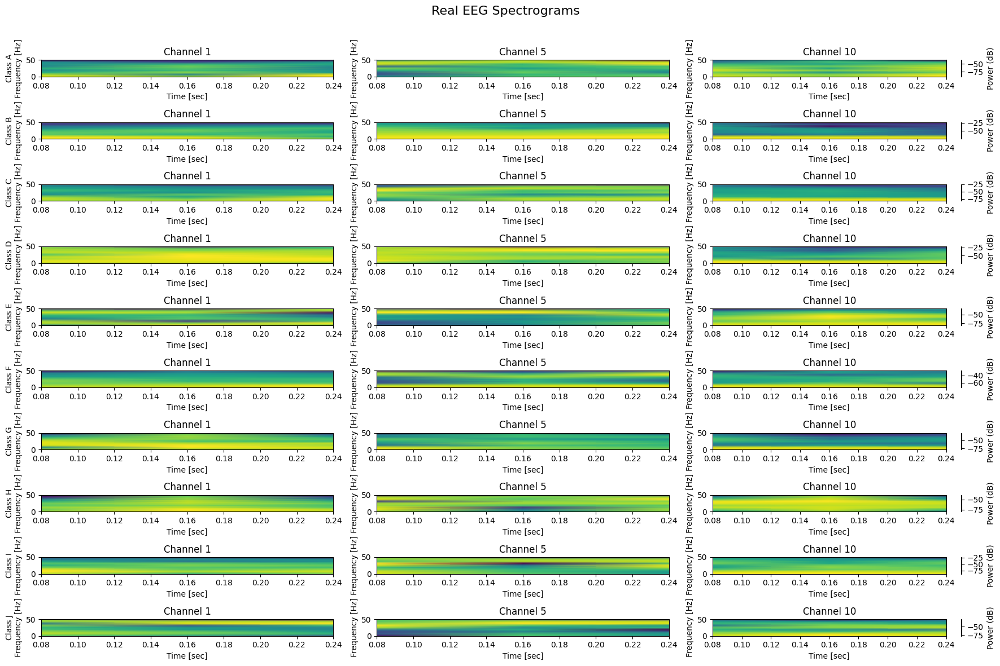

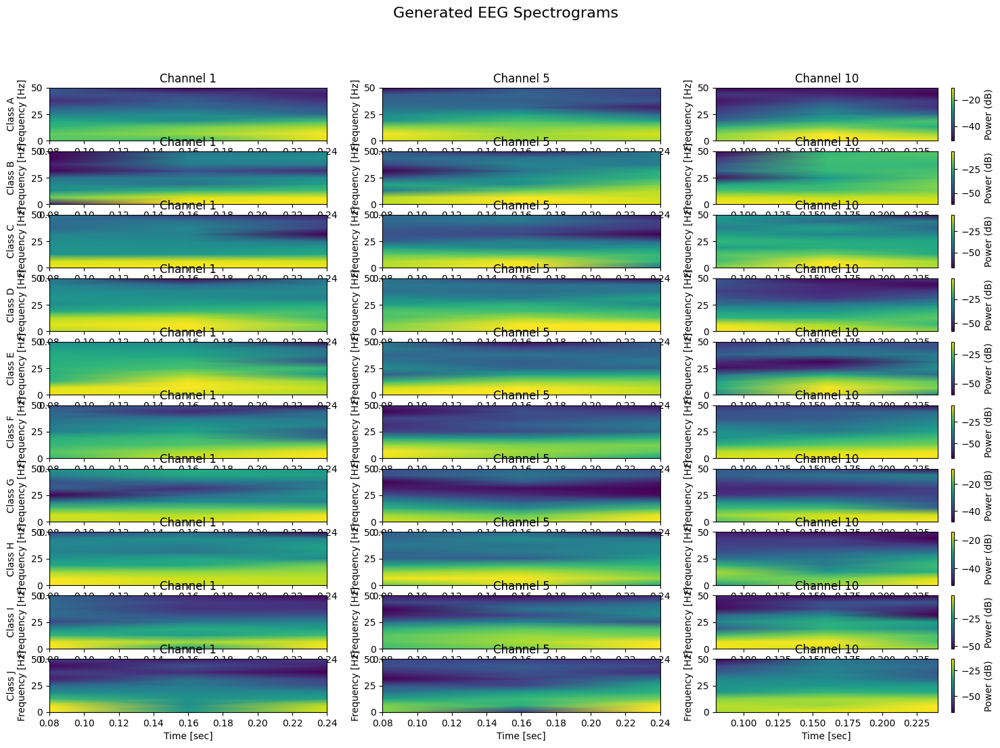

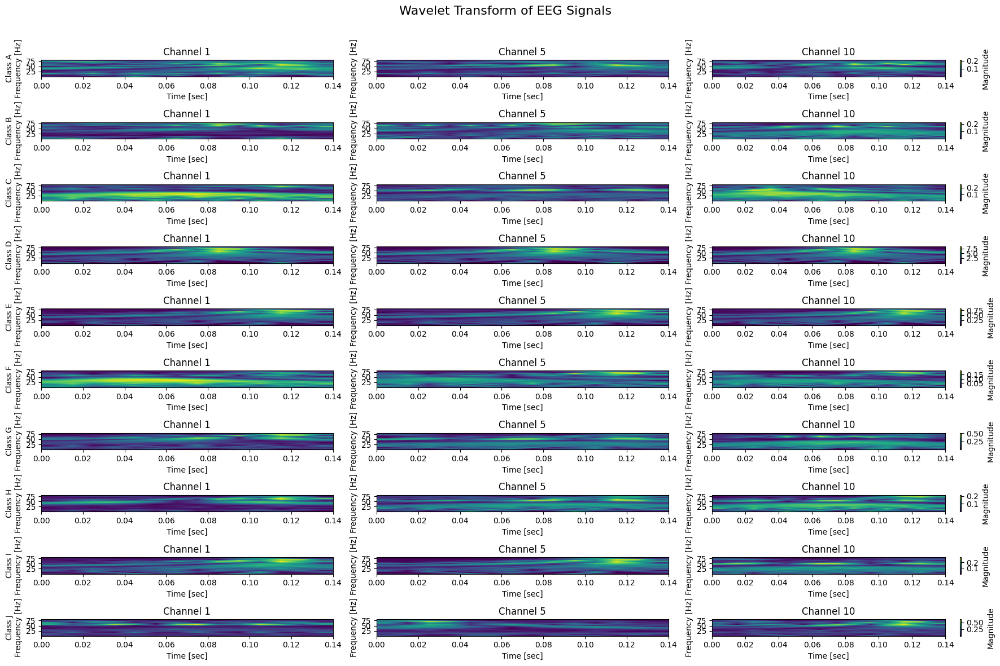

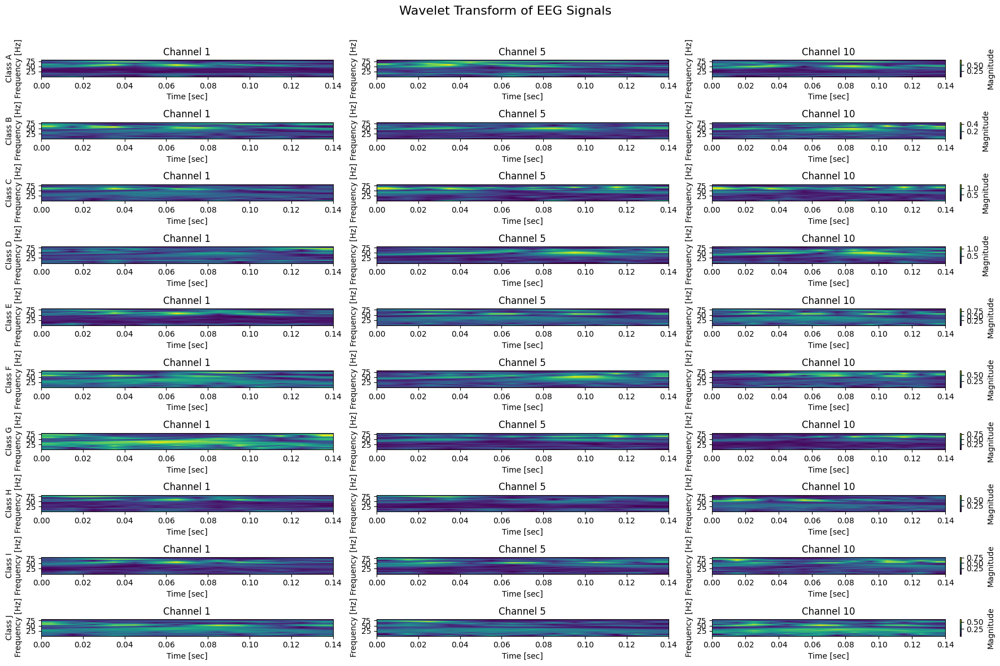

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
import matplotlib.cm as cm
import pywt
def perform_time_frequency_analysis(eeg_data, fs=100, nperseg=16, noverlap=8):
    """
    Perform time-frequency analysis using short-time Fourier transform (STFT)
    
    Args:
        eeg_data: Numpy array of shape (n_samples, n_channels, n_timepoints)
        fs: Sampling frequency in Hz (default: 100 Hz)
        nperseg: Length of each segment for STFT
        noverlap: Number of points to overlap between segments
        
    Returns:
        Spectrogram data for each sample and channel
    """
    eeg_data=np.transpose(eeg_data, (0, 2, 1))  # Transpose to (n_samples, n_timepoints, n_channels)
    n_samples, n_channels, n_timepoints = eeg_data.shape
    
    # Since your timepoints are limited (32), we'll use small window size
    # Adjust nperseg and noverlap based on your data
    
    # Initialize dictionary to store results
    spectrograms = {}
    
    for i in range(n_samples):
        spectrograms[i] = {}
        for j in range(n_channels):
            # Compute STFT
            f, t, Sxx = signal.spectrogram(
                eeg_data[i, j, :],
                fs=fs,
                window='hann',
                nperseg=nperseg,
                noverlap=noverlap,
                detrend=False,
                scaling='spectrum'
            )
            
            # Store results
            spectrograms[i][j] = {
                'frequencies': f,
                'times': t,
                'power': Sxx
            }
    
    return spectrograms

def visualize_spectrograms(spectrograms, sample_indices, channel_indices, class_labels=None):
    """
    Visualize spectrograms for selected samples and channels
    
    Args:
        spectrograms: Dictionary containing spectrogram data
        sample_indices: List of sample indices to visualize
        channel_indices: List of channel indices to visualize
        class_labels: Optional list of class labels
    """
    n_samples = len(sample_indices)
    n_channels = len(channel_indices)
    
    plt.figure(figsize=(15, n_samples * 3))
    
    for i, sample_idx in enumerate(sample_indices):
        for j, channel_idx in enumerate(channel_indices):
            spec_data = spectrograms[sample_idx][channel_idx]
            
            plt.subplot(n_samples, n_channels, i * n_channels + j + 1)
            
            # Plot spectrogram
            plt.pcolormesh(
                spec_data['times'],
                spec_data['frequencies'],
                10 * np.log10(spec_data['power'] + 1e-10),  # Convert to dB scale
                shading='gouraud',
                cmap='viridis'
            )
            
            plt.colorbar(label='Power/Frequency (dB/Hz)')
            
            # Add labels
            sample_label = f"Class {class_labels[i]}" if class_labels is not None else f"Sample {sample_idx}"
            plt.title(f"{sample_label}, Channel {channel_idx+1}")
            plt.xlabel('Time [sec]')
            plt.ylabel('Frequency [Hz]')
    
    plt.tight_layout()

def compare_real_vs_generated_spectrograms(real_data, generated_data, fs=100, nperseg=16, noverlap=8, 
                                          n_classes=10, samples_per_class=4000):
    """
    Compare spectrograms between real and generated EEG signals
    
    Args:
        real_data: Real EEG data
        generated_data: Generated EEG data
        fs: Sampling frequency
        nperseg: Length of each segment
        noverlap: Number of overlapping points
        n_classes: Number of classes
        samples_per_class: Number of samples per class
    """
    # Compute spectrograms for a subset of the data
    # Using 1 sample per class to avoid memory issues
    sample_indices = []
    for c in range(n_classes):
        # Select the middle sample from each class
        idx = c * samples_per_class + samples_per_class // 2
        sample_indices.append(idx)
    
    real_subset = real_data[sample_indices]
    generated_subset = generated_data[sample_indices]
    
    # Compute spectrograms
    real_spectrograms = perform_time_frequency_analysis(real_subset, fs, nperseg, noverlap)
    generated_spectrograms = perform_time_frequency_analysis(generated_subset, fs, nperseg, noverlap)
    
    # Visualize for selected channels (e.g., first 3 channels)
    channel_indices = [0, 4, 9]  # Channels 1, 5, and 10
    
    # Class labels
    class_labels = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J'][:n_classes]
    
    # Visualize real spectrograms
    plt.figure(figsize=(18, 12))
    plt.suptitle("Real EEG Spectrograms", fontsize=16)
    
    for i, sample_idx in enumerate(range(len(sample_indices))):
        for j, channel_idx in enumerate(channel_indices):
            spec_data = real_spectrograms[sample_idx][channel_idx]
            
            plt.subplot(len(sample_indices), len(channel_indices), i * len(channel_indices) + j + 1)
            
            # Plot spectrogram
            plt.pcolormesh(
                spec_data['times'],
                spec_data['frequencies'],
                10 * np.log10(spec_data['power'] + 1e-10),
                shading='gouraud',
                cmap='viridis'
            )
            
            if j == len(channel_indices) - 1:
                plt.colorbar(label='Power (dB)')
            
            # Add labels
            if j == 0:
                plt.ylabel(f"Class {class_labels[i]}\nFrequency [Hz]")
            else:
                plt.ylabel("Frequency [Hz]")
                
            plt.title(f"Channel {channel_idx+1}")
            plt.xlabel('Time [sec]')
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    
    # Visualize generated spectrograms
    plt.figure(figsize=(18, 12))
    plt.suptitle("Generated EEG Spectrograms", fontsize=16)
    
    for i, sample_idx in enumerate(range(len(sample_indices))):
        for j, channel_idx in enumerate(channel_indices):
            spec_data = generated_spectrograms[sample_idx][channel_idx]
            
            plt.subplot(len(sample_indices), len(channel_indices), i * len(channel_indices) + j + 1)
            
            # Plot spectrogram
            plt.pcolormesh(
                spec_data['times'],
                spec_data['frequencies'],
                10 * np.log10(spec_data['power'] + 1e-10),
                shading='gouraud',
                cmap='viridis'
            )
            
            if j == len(channel_indices) - 1:
                plt.colorbar(label='Power (dB)')
            
            # Add labels
            if j == 0:
                plt.ylabel(f"Class {class_labels[i]}\nFrequency [Hz]")
            else:
                plt.ylabel("Frequency [Hz]")
                
            plt.title(f"Channel {channel_idx+1}")
            plt.xlabel('Time [sec]')
    
    #plt.tight_layout(rect=[0, 0, 1, 0.96])

def analyze_wavelet_transform(eeg_data, fs=100, n_classes=10, samples_per_class=4000):
    """
    Perform wavelet transform analysis on EEG signals
    
    Args:
        eeg_data: EEG data
        fs: Sampling frequency
        n_classes: Number of classes
        samples_per_class: Number of samples per class
    """
    # Select one sample per class
    sample_indices = [c * samples_per_class + samples_per_class // 2 for c in range(n_classes)]
    selected_data = eeg_data[sample_indices]
    
    # Number of scales for wavelet transform
    num_scales = 20
    
    # Define scales for wavelet transform (more scales at lower frequencies)
    scales = np.logspace(0, 2.5, num_scales)
    
    # Convert scales to frequencies (for morlet wavelet)
    frequencies = pywt.scale2frequency('morl', scales) * fs
    
    # Select a subset of channels
    channel_indices = [0, 4, 9]  # Channels 1, 5, and 10
    
    # Class labels
    class_labels = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J'][:n_classes]
    
    # Plotting
    plt.figure(figsize=(18, 12))
    plt.suptitle("Wavelet Transform of EEG Signals", fontsize=16)
    
    for i, sample_idx in enumerate(range(len(sample_indices))):
        for j, channel_idx in enumerate(channel_indices):
            signal_data = selected_data[sample_idx, channel_idx, :]
            
            # Perform continuous wavelet transform
            coef, freqs = pywt.cwt(signal_data, scales, 'morl', 1/fs)
            
            # Plot
            plt.subplot(len(sample_indices), len(channel_indices), i * len(channel_indices) + j + 1)
            
            # Plot scalogram
            plt.imshow(
                np.abs(coef), 
                aspect='auto', 
                extent=[0, len(signal_data)/fs, frequencies[-1], frequencies[0]],
                cmap='viridis',
                interpolation='bilinear'
            )
            
            if j == len(channel_indices) - 1:
                plt.colorbar(label='Magnitude')
            
            # Add labels
            if j == 0:
                plt.ylabel(f"Class {class_labels[i]}\nFrequency [Hz]")
            else:
                plt.ylabel("Frequency [Hz]")
                
            plt.title(f"Channel {channel_idx+1}")
            plt.xlabel('Time [sec]')
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])

def main():
    """
    Main function to run the time-frequency analysis
    
    Args:
        real_data_path: Path to real EEG data
        generated_data_path: Path to generated EEG data
    """
    # Load data
    real_data = squeezed_data
    generated_data = generated_signals
    #generated_data = np.load(generated_data_path)
    
    print(f"Real data shape: {real_data.shape}")
    print(f"Generated data shape: {generated_data.shape}")
    
    # Sampling frequency (Hz)
    fs = 100  # Adjust this based on your data
    
    # For time-frequency analysis with limited time points,
    # use small window size and overlap
    nperseg = 16  # Window length for STFT
    noverlap = 8  # Overlap between windows
    
    # Compare spectrograms
    compare_real_vs_generated_spectrograms(
        real_data, 
        generated_data,
        fs=fs,
        nperseg=nperseg,
        noverlap=noverlap,
        n_classes=10,
        samples_per_class=4000
    )
    
    # Try to import PyWavelets for wavelet analysis
    try:
        import pywt
        # Analyze wavelets for real data
        analyze_wavelet_transform(real_data, fs=fs)
        # Analyze wavelets for generated data
        analyze_wavelet_transform(generated_data, fs=fs)
    except ImportError:
        print("PyWavelets not available. Skipping wavelet analysis.")
    
    # Show plots
    plt.show()

# Example usage:
main()

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
import os

def generate_spectrograms(real_data, gen_data, class_idx, output_dir="spectrograms"):
    """
    Generate spectrograms comparing real vs generated EEG signals
    
    Parameters:
    - real_data: numpy array of shape (n_samples, timepoints, channels) for real EEG data
    - gen_data: numpy array of shape (n_samples, timepoints, channels) for generated EEG data
    - class_idx: index of the class to visualize (0-9)
    - output_dir: directory to save the output figures
    """
    # Create output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)
    
    # Extract data for the specific class
    real_class_data = real_data[class_idx * 4000:(class_idx + 1) * 4000]
    gen_class_data = gen_data[class_idx * 4000:(class_idx + 1) * 4000]
    
    # Average across samples for more stable visualization
    real_avg = np.mean(real_class_data, axis=0)  # Shape: (32, 14)
    gen_avg = np.mean(gen_class_data, axis=0)    # Shape: (32, 14)
    
    # Figure 1: Time-Channel Heatmap
    plt.figure(figsize=(18, 8))
    
    plt.subplot(1, 2, 1)
    plt.title(f"Class {class_idx}: Real EEG Signal (Time-Channel)", fontsize=14)
    im1 = plt.imshow(real_avg, aspect='auto', cmap='viridis')
    plt.xlabel("Channels")
    plt.ylabel("Timepoints")
    plt.colorbar(im1, label="Amplitude")
    
    plt.subplot(1, 2, 2)
    plt.title(f"Class {class_idx}: Generated EEG Signal (Time-Channel)", fontsize=14)
    im2 = plt.imshow(gen_avg, aspect='auto', cmap='viridis')
    plt.xlabel("Channels")
    plt.ylabel("Timepoints")
    plt.colorbar(im2, label="Amplitude")
    
    plt.tight_layout()
    plt.savefig(f"{output_dir}/class_{class_idx}_time_channel_comparison.png", dpi=300)
    plt.close()
    
    # Figure 2: Spectrograms
    fs = 100  # Assuming 100 Hz sampling rate (modify as needed)
    plt.figure(figsize=(20, 14))
    
    for ch in range(14):
        # Real data spectrogram
        plt.subplot(7, 4, ch*2 + 1)
        f, t, Sxx = signal.spectrogram(real_avg[:, ch], fs=fs)
        plt.pcolormesh(t, f, 10 * np.log10(Sxx + 1e-10), shading='gouraud', cmap='inferno')
        plt.title(f"Real: Ch {ch+1}")
        plt.ylabel("Frequency (Hz)" if ch % 2 == 0 else "")
        if ch >= 12:
            plt.xlabel("Time (s)")
        
        # Generated data spectrogram
        plt.subplot(7, 4, ch*2 + 2)
        f, t, Sxx = signal.spectrogram(gen_avg[:, ch], fs=fs)
        plt.pcolormesh(t, f, 10 * np.log10(Sxx + 1e-10), shading='gouraud', cmap='inferno')
        plt.title(f"Generated: Ch {ch+1}")
        if ch >= 12:
            plt.xlabel("Time (s)")
    
    plt.tight_layout()
    plt.savefig(f"{output_dir}/class_{class_idx}_spectrograms.png", dpi=300)
    plt.close()

# Example usage:
def main():
    # Load your data here
    # Assuming data shape: (40000, 32, 14) for each array
    # Where 40000 = 10 classes * 4000 samples per class
    
    # Example with random data (replace with your actual data)
    real_data = squeezed_data # Real EEG signals
    gen_data = generate_spectrograms  # Generated EEG signals
    
    # Generate spectrograms for each class
    for class_idx in range(10):
        print(f"Generating spectrograms for class {class_idx}")
        generate_spectrograms(real_data, generated_signals, class_idx)
    
    print("Spectrograms generation complete!")

if __name__ == "__main__":
    main()

Generating spectrograms for class 0


C:\Users\Admin\AppData\Local\Temp\ipykernel_1492\4067179343.py:55: UserWarning: nperseg = 256 is greater than input length  = 32, using nperseg = 32
  f, t, Sxx = signal.spectrogram(real_avg[:, ch], fs=fs)
C:\Users\Admin\AppData\Local\Temp\ipykernel_1492\4067179343.py:64: UserWarning: nperseg = 256 is greater than input length  = 32, using nperseg = 32
  f, t, Sxx = signal.spectrogram(gen_avg[:, ch], fs=fs)


Generating spectrograms for class 1
Generating spectrograms for class 2
Generating spectrograms for class 3
Generating spectrograms for class 4
Generating spectrograms for class 5
Generating spectrograms for class 6
Generating spectrograms for class 7
Generating spectrograms for class 8
Generating spectrograms for class 9
Spectrograms generation complete!


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
import os

def generate_spectrograms(real_data, gen_data, class_idx, output_dir="spectrograms"):
    """
    Generate spectrograms comparing real vs generated EEG signals with standardized x-ticks
    
    Parameters:
    - real_data: numpy array of shape (n_samples, timepoints, channels) for real EEG data
    - gen_data: numpy array of shape (n_samples, timepoints, channels) for generated EEG data
    - class_idx: index of the class to visualize (0-9)
    - output_dir: directory to save the output figures
    """
    # Create output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)
    
    # Extract data for the specific class
    real_class_data = real_data[class_idx * 4000:(class_idx + 1) * 4000]
    gen_class_data = gen_data[class_idx * 4000:(class_idx + 1) * 4000]
    
    # Standardize data to be between -1 and 1
    def standardize(data):
        max_val = np.max(np.abs(data))
        if max_val > 0:
            return data / max_val
        return data
    
    # Average across samples for more stable visualization

    

    # Now take the mean of the filtered data
    real_avg = np.mean(real_class_data, axis=0)  # Shape: (32, 14)
    gen_avg = np.mean(gen_class_data, axis=0)    # Shape: (32, 14)
    
    # Standardize the data
    real_avg = standardize(real_avg)
    gen_avg = standardize(gen_avg)
    
    # Figure 1: Time-Channel Heatmap
    plt.figure(figsize=(18, 8))
    
    plt.subplot(1, 2, 1)
    plt.title(f"Class {class_idx}: Real EEG Signal (Time-Channel)", fontsize=14)
    im1 = plt.imshow(real_avg, aspect='auto', cmap='viridis', vmin=-1, vmax=1)
    plt.xlabel("Channels")
    plt.ylabel("Timepoints")
    plt.colorbar(im1, label="Amplitude (normalized)")
    
    plt.subplot(1, 2, 2)
    plt.title(f"Class {class_idx}: Generated EEG Signal (Time-Channel)", fontsize=14)
    im2 = plt.imshow(gen_avg, aspect='auto', cmap='viridis', vmin=-1, vmax=1)
    plt.xlabel("Channels")
    plt.ylabel("Timepoints")
    plt.colorbar(im2, label="Amplitude (normalized)")
    
    plt.tight_layout()
    plt.savefig(f"{output_dir}/class_{class_idx}_time_channel_comparison.png", dpi=300)
    plt.close()
    
    
    fs = 128  
    plt.figure(figsize=(20, 14))
    
    # Find global min and max for consistent color scaling across all spectrograms
    all_specs = []
    for ch in range(14):
        _, _, Sxx_real = signal.spectrogram(real_avg[:, ch], fs=fs)
        _, _, Sxx_gen = signal.spectrogram(gen_avg[:, ch], fs=fs)
        all_specs.append(np.log10(Sxx_real + 1e-10))
        all_specs.append(np.log10(Sxx_gen + 1e-10))
    
    vmin = -1
    vmax = 1
    
    for ch in range(14):
        # Real data spectrogram
        plt.subplot(7, 4, ch*2 + 1)
        f, t, Sxx = signal.spectrogram(real_avg[:, ch], fs=fs)
        
        # Normalize spectrogram values between -1 and 1
        Sxx_log = np.log10(Sxx + 1e-10)
        Sxx_norm = standardize(Sxx_log)
        
        plt.pcolormesh(t, f, Sxx_norm, shading='gouraud', cmap='inferno', vmin=vmin, vmax=vmax)
        plt.title(f"Real: Ch {ch+1}")
        plt.ylabel("Frequency (Hz)" if ch % 2 == 0 else "")
        if ch >= 12:
            plt.xlabel("Time (s)")
        plt.colorbar(label="Power (normalized)")
        
        # Generated data spectrogram
        plt.subplot(7, 4, ch*2 + 2)
        f, t, Sxx = signal.spectrogram(gen_avg[:, ch], fs=fs)
        
        # Normalize spectrogram values between -1 and 1
        Sxx_log = np.log10(Sxx + 1e-10)
        Sxx_norm = standardize(Sxx_log)
        
        plt.pcolormesh(t, f, Sxx_norm, shading='gouraud', cmap='inferno', vmin=vmin, vmax=vmax)
        plt.title(f"Generated: Ch {ch+1}")
        if ch >= 12:
            plt.xlabel("Time (s)")
        plt.colorbar(label="Power (normalized)")
    
    plt.tight_layout()
    plt.savefig(f"{output_dir}/class_{class_idx}_spectrograms.png", dpi=300)
    plt.close()

# Example usage:
def main():
    # Load your data here
    # Assuming data shape: (40000, 32, 14) for each array
    # Where 40000 = 10 classes * 4000 samples per class
    
    # Example with random data (replace with your actual data)
    real_data = squeezed_data  # Real EEG signals
    gen_data = generated_signals  # Generated EEG signals
    
    # Generate spectrograms for each class
    for class_idx in range(10):
        print(f"Generating spectrograms for class {class_idx}")
        generate_spectrograms(real_data, gen_data, class_idx)
    
    print("Spectrograms generation complete!")

if __name__ == "__main__":
    main()

Generating spectrograms for class 0


C:\Users\Admin\AppData\Local\Temp\ipykernel_1492\730711799.py:76: UserWarning: nperseg = 256 is greater than input length  = 32, using nperseg = 32
  _, _, Sxx_real = signal.spectrogram(real_avg[:, ch], fs=fs)
C:\Users\Admin\AppData\Local\Temp\ipykernel_1492\730711799.py:77: UserWarning: nperseg = 256 is greater than input length  = 32, using nperseg = 32
  _, _, Sxx_gen = signal.spectrogram(gen_avg[:, ch], fs=fs)
C:\Users\Admin\AppData\Local\Temp\ipykernel_1492\730711799.py:87: UserWarning: nperseg = 256 is greater than input length  = 32, using nperseg = 32
  f, t, Sxx = signal.spectrogram(real_avg[:, ch], fs=fs)
C:\Users\Admin\AppData\Local\Temp\ipykernel_1492\730711799.py:102: UserWarning: nperseg = 256 is greater than input length  = 32, using nperseg = 32
  f, t, Sxx = signal.spectrogram(gen_avg[:, ch], fs=fs)


Generating spectrograms for class 1
Generating spectrograms for class 2
Generating spectrograms for class 3
Generating spectrograms for class 4
Generating spectrograms for class 5
Generating spectrograms for class 6
Generating spectrograms for class 7
Generating spectrograms for class 8
Generating spectrograms for class 9
Spectrograms generation complete!


In [17]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
import os

def generate_spectrograms(real_data, gen_data, class_idx, output_dir="spectrograms"):
    """
    Generate spectrograms comparing real vs generated EEG signals with standardized x-ticks
    
    Parameters:
    - real_data: numpy array of shape (n_samples, timepoints, channels) for real EEG data
    - gen_data: numpy array of shape (n_samples, timepoints, channels) for generated EEG data
    - class_idx: index of the class to visualize (0-9)
    - output_dir: directory to save the output figures
    """
    # Create output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)
    
    # Extract data for the specific class
    real_class_data = real_data[class_idx * 4000:(class_idx + 1) * 4000]
    gen_class_data = gen_data[class_idx * 4000:(class_idx + 1) * 4000]
    
    # Standardize data to be between -1 and 1
    def standardize(data):
        max_val = np.max(np.abs(data))
        if max_val > 0:
            return data / max_val
        return data
    
    fs = 128  # Sampling frequency
    
    # Figure 1: Average Spectrogram Heatmap across channels
    plt.figure(figsize=(18, 8))
    
    # Initialize arrays to store the average spectrograms for all channels
    avg_real_all_ch = np.zeros((14, 129, 32))  # Initialize with expected spectrogram dimensions (channels, freq, time)
    avg_gen_all_ch = np.zeros((14, 129, 32))   # These dimensions will match what scipy.signal.spectrogram produces
    
    # Compute spectrograms for each channel and sample, then average
    num_samples = min(100, len(real_class_data))  # Limit to 100 samples for efficiency
    
    for ch in range(14):
        # Real data spectrograms
        real_specs = []
        for i in range(num_samples):
            f, t, Sxx = signal.spectrogram(real_class_data[i:i+1, :, ch], fs=fs)
            print(f.shape, t.shape, Sxx.shape)
            Sxx_log = np.log10(Sxx + 1e-10)  # Add small constant to avoid log(0)
            print(Sxx.shape)
            real_specs.append(Sxx_log)
        
        # Average the spectrograms for this channel
        avg_real_spec = np.mean(real_specs, axis=0)
        avg_real_all_ch[ch] = avg_real_spec
        
        # Generated data spectrograms
        gen_specs = []
        for i in range(num_samples):
            f, t, Sxx = signal.spectrogram(gen_class_data[i, :, ch], fs=fs)
            Sxx_log = np.log10(Sxx + 1e-10)
            gen_specs.append(Sxx_log)
        
        # Average the spectrograms for this channel
        avg_gen_spec = np.mean(gen_specs, axis=0)
        avg_gen_all_ch[ch] = avg_gen_spec
    
    # Standardize the spectrogram arrays
    avg_real_all_ch_norm = standardize(avg_real_all_ch)
    avg_gen_all_ch_norm = standardize(avg_gen_all_ch)
    
    # For the first plot, we'll create a combined time-frequency representation across channels
    # by taking the mean spectrogram across all time points for each channel
    real_mean_over_time = np.mean(avg_real_all_ch_norm, axis=2)  # Average across time dimension
    gen_mean_over_time = np.mean(avg_gen_all_ch_norm, axis=2)    # Average across time dimension
    
    # Plot real data spectrogram
    plt.subplot(1, 2, 1)
    plt.title(f"Class {class_idx}: Real EEG Spectrogram (Channel-Frequency)", fontsize=14)
    im1 = plt.imshow(real_mean_over_time, aspect='auto', cmap='viridis', vmin=-1, vmax=1)
    plt.xlabel("Frequency (index)")
    plt.ylabel("Channels")
    plt.colorbar(im1, label="Power (normalized)")
    
    # Plot generated data spectrogram
    plt.subplot(1, 2, 2)
    plt.title(f"Class {class_idx}: Generated EEG Spectrogram (Channel-Frequency)", fontsize=14)
    im2 = plt.imshow(gen_mean_over_time, aspect='auto', cmap='viridis', vmin=-1, vmax=1)
    plt.xlabel("Frequency (index)")
    plt.ylabel("Channels")
    plt.colorbar(im2, label="Power (normalized)")
    
    plt.tight_layout()
    plt.savefig(f"{output_dir}/class_{class_idx}_spectrogram_channel_freq.png", dpi=300)
    plt.close()
    
    # Figure 2: Detailed Spectrograms - Per channel comparisons
    plt.figure(figsize=(20, 14))
    
    # Find global min and max for consistent color scaling
    vmin = -1
    vmax = 1
    
    # For the second plot, we'll show the detailed spectrograms for each channel
    for ch in range(14):
        # Plot real data spectrogram
        plt.subplot(7, 4, ch*2 + 1)
        plt.pcolormesh(t, f, avg_real_all_ch_norm[ch], shading='gouraud', cmap='inferno', vmin=vmin, vmax=vmax)
        plt.title(f"Real: Ch {ch+1}")
        plt.ylabel("Frequency (Hz)" if ch % 2 == 0 else "")
        if ch >= 12:
            plt.xlabel("Time (s)")
        plt.colorbar(label="Power (normalized)")
        
        # Plot generated data spectrogram
        plt.subplot(7, 4, ch*2 + 2)
        plt.pcolormesh(t, f, avg_gen_all_ch_norm[ch], shading='gouraud', cmap='inferno', vmin=vmin, vmax=vmax)
        plt.title(f"Generated: Ch {ch+1}")
        if ch >= 12:
            plt.xlabel("Time (s)")
        plt.colorbar(label="Power (normalized)")
    
    plt.tight_layout()
    plt.savefig(f"{output_dir}/class_{class_idx}_spectrograms_per_channel.png", dpi=300)
    plt.close()

# Example usage:
def main():
    # Load your data here
    # Assuming data shape: (40000, 32, 14) for each array
    # Where 40000 = 10 classes * 4000 samples per class
    
    # Example with random data (replace with your actual data)
    real_data = squeezed_data  # Real EEG signals
    gen_data = generated_signals  # Generated EEG signals
    
    # Generate spectrograms for each class
    for class_idx in range(10):
        print(f"Generating spectrograms for class {class_idx}")
        generate_spectrograms(real_data, gen_data, class_idx)
    
    print("Spectrograms generation complete!")

if __name__ == "__main__":
    main()

Generating spectrograms for class 0
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (1,) (1, 17, 1)
(1, 17, 1)
(17,) (

C:\Users\Admin\AppData\Local\Temp\ipykernel_1492\445469060.py:46: UserWarning: nperseg = 256 is greater than input length  = 32, using nperseg = 32
  f, t, Sxx = signal.spectrogram(real_class_data[i:i+1, :, ch], fs=fs)


ValueError: could not broadcast input array from shape (17,1) into shape (129,32)

<Figure size 1800x800 with 0 Axes>

In [56]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
import seaborn as sns
def extract_power_features(eeg_data, fs=100, bands=None):
    """
    Extract power features from EEG data
    
    Args:
        eeg_data: EEG data array (n_samples, n_channels, n_timepoints)
        fs: Sampling frequency
        bands: Dictionary of frequency bands {band_name: (low_freq, high_freq)}
        
    Returns:
        Features array (n_samples, n_channels * n_bands)
    """
    if bands is None:
        bands = {
            'delta': (0.5, 4),
            'theta': (4, 8),
            'alpha': (8, 13),
            'beta': (13, 30)
        }
    eeg_data=np.transpose(eeg_data, (0, 2, 1))  # Transpose to (n_samples, n_timepoints, n_channels)
    n_samples, n_channels, n_timepoints = eeg_data.shape
    n_bands = len(bands)
    
    # Calculate frequency resolution
    freq_res = fs / n_timepoints
    
    # Calculate the number of frequencies in FFT
    n_freqs = n_timepoints // 2 + 1
    
    # Create frequency array
    freqs = np.fft.rfftfreq(n_timepoints, d=1/fs)
    
    # Initialize features array
    features = np.zeros((n_samples, n_channels * n_bands))
    
    # Compute power spectrum for each sample and channel
    for i in range(n_samples):
        for j in range(n_channels):
            # Compute FFT
            signal_fft = np.fft.rfft(eeg_data[i, j, :])
            
            # Compute power spectrum
            power = np.abs(signal_fft) ** 2
            
            # Extract band powers
            band_idx = 0
            for band_name, (low_freq, high_freq) in bands.items():
                # Find frequency indices for this band
                band_indices = np.where((freqs >= low_freq) & (freqs <= high_freq))[0]
                
                if len(band_indices) > 0:
                    # Compute band power
                    band_power = np.sum(power[band_indices])
                    
                    # Store feature
                    features[i, j * n_bands + band_idx] = band_power
                
                band_idx += 1
    
    return features
def compare_power_distributions(real_data, generated_data, n_classes=10, samples_per_class=4000, fs=100):
    """
    Compare power distributions between real and generated EEG data
    
    Args:
        real_data: Real EEG data
        generated_data: Generated EEG data
        n_classes: Number of classes
        samples_per_class: Number of samples per class
        fs: Sampling frequency
    
    Returns:
        Statistical comparison metrics and visualization
    """
    # Define frequency bands
    bands = {
        'delta': (0.5, 4),
        'theta': (4, 8),
        'alpha': (8, 13),
        'beta': (13, 30)
    }
    
    # Extract power features
    real_features = extract_power_features(real_data, fs=fs, bands=bands)
    generated_features = extract_power_features(generated_data, fs=fs, bands=bands)
    
    # Get dimensions
    n_channels = real_data.shape[1]
    n_bands = len(bands)
    
    # Setup figure for visualization
    fig, axes = plt.subplots(n_channels, n_bands, figsize=(15, 10), sharex=True)
    band_names = list(bands.keys())
    statistical_results = {}
    
    # Compare distributions for each channel and band
    for channel in range(n_channels):
        statistical_results[f'channel_{channel}'] = {}
        print(f"Channel {channel + 1}:")
        for band_idx, band_name in enumerate(band_names):
            # Extract features for this channel and band
            
            real_band_power = real_features[:, channel * n_bands + band_idx]
            generated_band_power = generated_features[:, channel * n_bands + band_idx]
            
            # Perform statistical test (Kolmogorov-Smirnov test for distribution comparison)
            ks_stat, p_value = stats.ks_2samp(real_band_power, generated_band_power)
            statistical_results[f'channel_{channel}'][band_name] = {
                'ks_statistic': ks_stat,
                'p_value': p_value
            }
            
            # Plot distributions
            if n_channels == 1:
                ax = axes[band_idx]
            else:
                ax = axes[channel, band_idx]
                
            sns.histplot(real_band_power, kde=True, color='blue', alpha=0.5, label='Real', ax=ax)
            sns.histplot(generated_band_power, kde=True, color='red', alpha=0.5, label='Generated', ax=ax)
            
            # Add title and statistics
            ax.set_title(f'Ch{channel+1} {band_name.capitalize()}\np={p_value:.4f}')
            
            # Only add legend to the first subplot
            if channel == 0 and band_idx == 0:
                ax.legend()
            
            # Add x-label only to the bottom row
            if channel == n_channels - 1:
                ax.set_xlabel('Power')
            
            # Add y-label only to the first column
            if band_idx == 0:
                ax.set_ylabel('Frequency')
    
    # Adjust layout
    plt.tight_layout()
    
    # Calculate overall similarity metric
    significant_differences = sum(1 for ch in statistical_results.values() 
                                 for band in ch.values() 
                                 if band['p_value'] < 0.05)
    total_comparisons = n_channels * n_bands
    similarity_score = 1 - (significant_differences / total_comparisons)
    
    print(f"Overall similarity score: {similarity_score:.4f}")
    print(f"Statistically different distributions: {significant_differences}/{total_comparisons}")
    
    return statistical_results, similarity_score, fig

In [ ]:
compare_power_distributions(squeezed_data, generated_signals, n_classes=10, samples_per_class=4000, fs=100)

Channel 1:
Channel 2:
Channel 3:
Channel 4:
Channel 5:
Channel 6:
Channel 7:


KeyboardInterrupt: 

C:\Users\Admin\AppData\Roaming\Python\Python312\site-packages\IPython\core\events.py:82: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


Error in callback <function _draw_all_if_interactive at 0x0000023A759D8220> (for post_execute), with arguments args (),kwargs {}:


KeyboardInterrupt: 

C:\Users\Admin\AppData\Roaming\Python\Python312\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


In [ ]:
def compare_power_distributions(real_data, generated_data, n_classes=10, samples_per_class=4000, fs=100):
    """
    Compare power distributions between real and generated EEG data
    
    Args:
        real_data: Real EEG data (n_samples, n_channels, n_timepoints)
        generated_data: Generated EEG data (n_samples, n_channels, n_timepoints)
        n_classes: Number of classes
        samples_per_class: Number of samples per class
        fs: Sampling frequency
    
    Returns:
        Statistical comparison metrics and visualization
    """
    # Define frequency bands
    bands = {
        'delta': (0.5, 4),
        'theta': (4, 8),
        'alpha': (8, 13),
        'beta': (13, 30)
    }
    
    # Extract power features
    real_features = extract_power_features(real_data, fs=fs, bands=bands)
    generated_features = extract_power_features(generated_data, fs=fs, bands=bands)
    
    # Get dimensions
    n_channels = real_data.shape[1]
    n_bands = len(bands)
    
    # Setup figure for visualization
    fig, axes = plt.subplots(n_channels, n_bands, figsize=(15, 10), sharex=True)
    band_names = list(bands.keys())
    statistical_results = {}
    
    # Compare distributions for each channel and band
    for channel in range(n_channels):
        statistical_results[f'channel_{channel}'] = {}
        
        for band_idx, band_name in enumerate(band_names):
            # Extract features for this channel and band
            real_band_power = real_features[:, channel * n_bands + band_idx]
            generated_band_power = generated_features[:, channel * n_bands + band_idx]
            
            # Perform statistical test (Kolmogorov-Smirnov test for distribution comparison)
            ks_stat, p_value = stats.ks_2samp(real_band_power, generated_band_power)
            statistical_results[f'channel_{channel}'][band_name] = {
                'ks_statistic': ks_stat,
                'p_value': p_value
            }
            
            # Plot distributions
            if n_channels == 1:
                ax = axes[band_idx]
            else:
                ax = axes[channel, band_idx]
                
            sns.histplot(real_band_power, kde=True, color='blue', alpha=0.5, label='Real', ax=ax)
            sns.histplot(generated_band_power, kde=True, color='red', alpha=0.5, label='Generated', ax=ax)
            
            # Add title and statistics
            ax.set_title(f'Ch{channel+1} {band_name.capitalize()}\np={p_value:.4f}')
            
            # Only add legend to the first subplot
            if channel == 0 and band_idx == 0:
                ax.legend()
            
            # Add x-label only to the bottom row
            if channel == n_channels - 1:
                ax.set_xlabel('Power')
            
            # Add y-label only to the first column
            if band_idx == 0:
                ax.set_ylabel('Frequency')
    
    # Adjust layout
    plt.tight_layout()
    
    # Calculate overall similarity metric
    significant_differences = sum(1 for ch in statistical_results.values() 
                                 for band in ch.values() 
                                 if band['p_value'] < 0.05)
    total_comparisons = n_channels * n_bands
    similarity_score = 1 - (significant_differences / total_comparisons)
    
    print(f"Overall similarity score: {similarity_score:.4f}")
    print(f"Statistically different distributions: {significant_differences}/{total_comparisons}")
    
    return statistical_results, similarity_score, fig

def classify_eeg_features(real_features, generated_features, real_labels, generated_labels):
    """
    Classify EEG features to evaluate discriminability between real and generated data
    
    Args:
        real_features: Features extracted from real EEG data
        generated_features: Features extracted from generated EEG data
        real_labels: Class labels for real data
        generated_labels: Class labels for generated data
    
    Returns:
        Classification metrics and visualization
    """
    # Combine real and generated data
    X = np.vstack([real_features, generated_features])
    y_class = np.hstack([real_labels, generated_labels])
    y_real = np.hstack([np.ones(len(real_features)), np.zeros(len(generated_features))])
    
    # Split data for training and testing
    X_train, X_test, y_class_train, y_class_test, y_real_train, y_real_test = train_test_split(
        X, y_class, y_real, test_size=0.3, random_state=42, stratify=y_class
    )
    
    # Train LDA for class prediction
    class_lda = LinearDiscriminantAnalysis()
    class_lda.fit(X_train, y_class_train)
    class_preds = class_lda.predict(X_test)
    
    # Train LDA for real vs generated discrimination
    real_lda = LinearDiscriminantAnalysis()
    real_lda.fit(X_train, y_real_train)
    real_preds = real_lda.predict(X_test)
    
    # Evaluate class prediction
    print("Class Prediction Results:")
    print(classification_report(y_class_test, class_preds))
    
    class_cm = confusion_matrix(y_class_test, class_preds)
    
    # Evaluate real vs generated discrimination
    print("\nReal vs Generated Discrimination Results:")
    print(classification_report(y_real_test, real_preds))
    
    real_cm = confusion_matrix(y_real_test, real_preds)
    
    # Visualize confusion matrices
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    
    sns.heatmap(class_cm, annot=True, fmt='d', cmap='Blues', ax=axes[0])
    axes[0].set_title('Class Prediction Confusion Matrix')
    axes[0].set_xlabel('Predicted Class')
    axes[0].set_ylabel('True Class')
    
    sns.heatmap(real_cm, annot=True, fmt='d', cmap='Blues', ax=axes[1])
    axes[1].set_title('Real vs Generated Confusion Matrix')
    axes[1].set_xlabel('Predicted (1=Real, 0=Generated)')
    axes[1].set_ylabel('True (1=Real, 0=Generated)')
    
    plt.tight_layout()
    
    # Calculate metrics
    class_accuracy = (class_cm.diagonal().sum() / class_cm.sum()) * 100
    real_accuracy = (real_cm.diagonal().sum() / real_cm.sum()) * 100
    
    print(f"\nClass prediction accuracy: {class_accuracy:.2f}%")
    print(f"Real vs Generated discrimination accuracy: {real_accuracy:.2f}%")
    
    return {
        'class_accuracy': class_accuracy,
        'real_accuracy': real_accuracy,
        'class_report': classification_report(y_class_test, class_preds, output_dict=True),
        'real_report': classification_report(y_real_test, real_preds, output_dict=True),
        'visualization': fig
    }

def visualize_feature_distributions(real_data, generated_data, fs=100):
    """
    Visualize the distribution of power features across all classes
    
    Args:
        real_data: Real EEG data (n_samples, n_channels, n_timepoints)
        generated_data: Generated EEG data (n_samples, n_channels, n_timepoints)
        fs: Sampling frequency
    
    Returns:
        Visualization of feature distributions
    """
    # Define frequency bands
    bands = {
        'delta': (0.5, 4),
        'theta': (4, 8),
        'alpha': (8, 13),
        'beta': (13, 30)
    }
    
    # Extract power features
    real_features = extract_power_features(real_data, fs=fs, bands=bands)
    generated_features = extract_power_features(generated_data, fs=fs, bands=bands)
    
    # Get dimensions
    n_channels = real_data.shape[1]
    n_bands = len(bands)
    n_features = real_features.shape[1]
    
    # Calculate feature means and standard deviations
    real_means = np.mean(real_features, axis=0)
    real_stds = np.std(real_features, axis=0)
    gen_means = np.mean(generated_features, axis=0)
    gen_stds = np.std(generated_features, axis=0)
    
    # Create feature labels
    feature_labels = []
    for ch in range(n_channels):
        for band in bands.keys():
            feature_labels.append(f"Ch{ch+1}_{band}")
    
    # Plot feature distributions
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 10), sharex=True)
    
    # Plot means
    x = np.arange(n_features)
    width = 0.35
    
    ax1.bar(x - width/2, real_means, width, label='Real', color='blue', alpha=0.7)
    ax1.bar(x + width/2, gen_means, width, label='Generated', color='red', alpha=0.7)
    ax1.set_ylabel('Mean Power')
    ax1.set_title('Mean Power by Feature')
    ax1.set_xticks(x)
    ax1.set_xticklabels(feature_labels, rotation=90)
    ax1.legend()
    
    # Plot standard deviations
    ax2.bar(x - width/2, real_stds, width, label='Real', color='blue', alpha=0.7)
    ax2.bar(x + width/2, gen_stds, width, label='Generated', color='red', alpha=0.7)
    ax2.set_ylabel('Power Standard Deviation')
    ax2.set_title('Power Standard Deviation by Feature')
    ax2.set_xticks(x)
    ax2.set_xticklabels(feature_labels, rotation=90)
    ax2.legend()
    
    plt.tight_layout()
    
    # Calculate mean absolute percentage error between real and generated means
    mape = np.mean(np.abs((real_means - gen_means) / real_means)) * 100
    
    print(f"Mean Absolute Percentage Error between real and generated means: {mape:.2f}%")
    
    return fig, mape

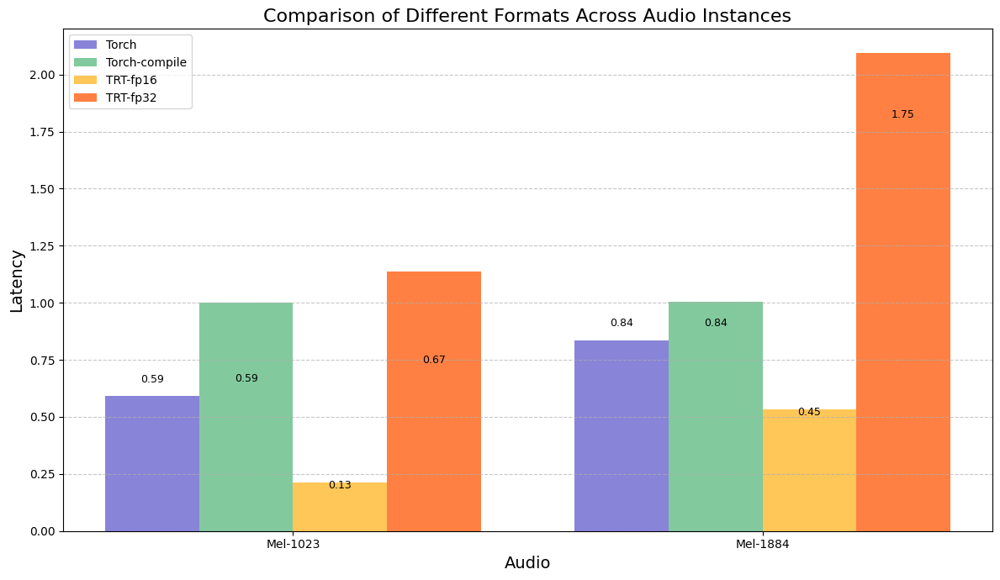


Summary Statistics:
          Audio     Torch  Torch-compile  TRT-fp16  TRT-fp32
count  2.000000  2.000000       2.000000  2.000000  2.000000
mean   0.500000  0.713066       0.714606  0.285379  1.211368
std    0.707107  0.172600       0.173470  0.226264  0.761558
min    0.000000  0.591019       0.591944  0.125386  0.672866
25%    0.250000  0.652042       0.653275  0.205383  0.942117
50%    0.500000  0.713066       0.714606  0.285379  1.211368
75%    0.750000  0.774089       0.775937  0.365376  1.480619
max    1.000000  0.835112       0.837268  0.445372  1.749870

Performance Improvement vs Torch:
Torch-compile: [-0.15655338883179234, -0.2581723605610201] %
TRT-fp16: [78.78471091580647, 46.66921443226956] %
TRT-fp32: [-13.848343176045805, -109.53717735687046] %


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Read the CSV file
df = pd.read_csv('inference_summary_all_texts_16.csv')

# Set figure size
plt.figure(figsize=(12, 7))

# Set up positions for the bars
x = np.arange(len(df['Audio']))
width = 0.2  # Width of each bar

# Create the bars for each format
plt.bar(x - width*1.5, df['Torch']/df["torch"], width, label='Torch', color='#8884d8')
plt.bar(x - width/2, df['Torch-compile']/df["Torch"], width, label='Torch-compile', color='#82ca9d')
plt.bar(x + width/2, df['TRT-fp16']/df["Torch"], width, label='TRT-fp16', color='#ffc658')
plt.bar(x + width*1.5, df['TRT-fp32']/df["Torch"], width, label='TRT-fp32', color='#ff8042')
xticks=["Mel-1023","Mel-1884"]
# Add labels, title and legend
plt.xlabel('Audio', fontsize=14)
plt.ylabel('Latency', fontsize=14)
plt.title('Comparison of Different Formats Across Audio Instances', fontsize=16)
plt.xticks(x, [i for i in xticks])
plt.legend(loc='upper left')

# Add grid for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Add value labels on top of bars
for i, format_name in enumerate(['Torch', 'Torch-compile', 'TRT-fp16', 'TRT-fp32']):
    for j, value in enumerate(df[format_name]):
        position = x[j] - width*1.5 + i*width
        plt.text(position, value + 0.05, f'{value:.2f}', 
                 ha='center', va='bottom', fontsize=9, rotation=0)

# Adjust layout and save
plt.tight_layout()
plt.savefig('audio_format_comparison.png', dpi=300)

# Display the plot
plt.show()

# Print summary statistics
print("\nSummary Statistics:")
print(df.describe())

# Calculate performance improvement percentages (assuming lower is better)
print("\nPerformance Improvement vs Torch:")
for format_name in ['Torch-compile', 'TRT-fp16', 'TRT-fp32']:
    improvement = ((df['Torch'] - df[format_name]) / df['Torch']) * 100
    print(f"{format_name}: {improvement.tolist()} %")

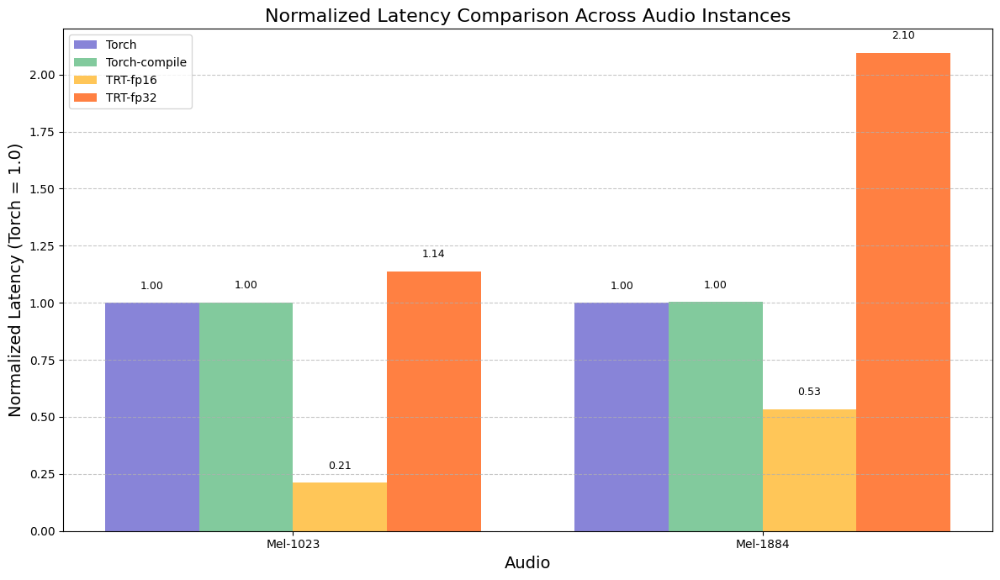


Summary Statistics (Original Values):
          Audio     Torch  Torch-compile  TRT-fp16  TRT-fp32
count  2.000000  2.000000       2.000000  2.000000  2.000000
mean   0.500000  0.713066       0.714606  0.285379  1.211368
std    0.707107  0.172600       0.173470  0.226264  0.761558
min    0.000000  0.591019       0.591944  0.125386  0.672866
25%    0.250000  0.652042       0.653275  0.205383  0.942117
50%    0.500000  0.713066       0.714606  0.285379  1.211368
75%    0.750000  0.774089       0.775937  0.365376  1.480619
max    1.000000  0.835112       0.837268  0.445372  1.749870

Summary Statistics (Normalized Values):
       Torch  Torch-compile  TRT-fp16  TRT-fp32
count    2.0       2.000000  2.000000  2.000000
mean     1.0       1.002074  0.372730  1.616928
std      0.0       0.000719  0.227091  0.676622
min      1.0       1.001566  0.212153  1.138483
25%      1.0       1.001820  0.292442  1.377706
50%      1.0       1.002074  0.372730  1.616928
75%      1.0       1.002328  0.4530

In [39]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Read the CSV file
df = pd.read_csv('inference_summary_all_texts_16.csv')

# Set figure size
plt.figure(figsize=(12, 7))

# Set up positions for the bars
x = np.arange(len(df['Audio']))
width = 0.2  # Width of each bar

# Calculate normalized values (relative to Torch)
normalized_values = {
    'Torch': df['Torch'] / df['Torch'],  # This will always be 1.0
    'Torch-compile': df['Torch-compile'] / df['Torch'],
    'TRT-fp16': df['TRT-fp16'] / df['Torch'],
    'TRT-fp32': df['TRT-fp32'] / df['Torch']
}

# Create the bars for each format with normalized values
plt.bar(x - width*1.5, normalized_values['Torch'], width, label='Torch', color='#8884d8')
plt.bar(x - width/2, normalized_values['Torch-compile'], width, label='Torch-compile', color='#82ca9d')
plt.bar(x + width/2, normalized_values['TRT-fp16'], width, label='TRT-fp16', color='#ffc658')
plt.bar(x + width*1.5, normalized_values['TRT-fp32'], width, label='TRT-fp32', color='#ff8042')

# Set custom x-tick labels
xticks = ["Mel-1023", "Mel-1884"]

# Add labels, title and legend
plt.xlabel('Audio', fontsize=14)
plt.ylabel('Normalized Latency (Torch = 1.0)', fontsize=14)  # Updated label
plt.title('Normalized Latency Comparison Across Audio Instances', fontsize=16)
plt.xticks(x, xticks)
plt.legend(loc='upper left')

# Add grid for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Add value labels on top of bars with normalized values
for i, format_name in enumerate(['Torch', 'Torch-compile', 'TRT-fp16', 'TRT-fp32']):
    for j, value in enumerate(normalized_values[format_name]):
        position = x[j] - width*1.5 + i*width
        plt.text(position, value + 0.05, f'{value:.2f}', 
                 ha='center', va='bottom', fontsize=9, rotation=0)

# Adjust layout and save
plt.tight_layout()
plt.savefig('normalized_audio_format_comparison.png', dpi=300)

# Display the plot
plt.show()

# Print summary statistics of original data
print("\nSummary Statistics (Original Values):")
print(df.describe())

# Print summary statistics of normalized data
print("\nSummary Statistics (Normalized Values):")
normalized_df = pd.DataFrame(normalized_values)
print(normalized_df.describe())

# Calculate performance improvement percentages
print("\nPerformance Improvement vs Torch:")
for format_name in ['Torch-compile', 'TRT-fp16', 'TRT-fp32']:
    improvement = ((df['Torch'] - df[format_name]) / df['Torch']) * 100
    print(f"{format_name}: {improvement.tolist()} %")

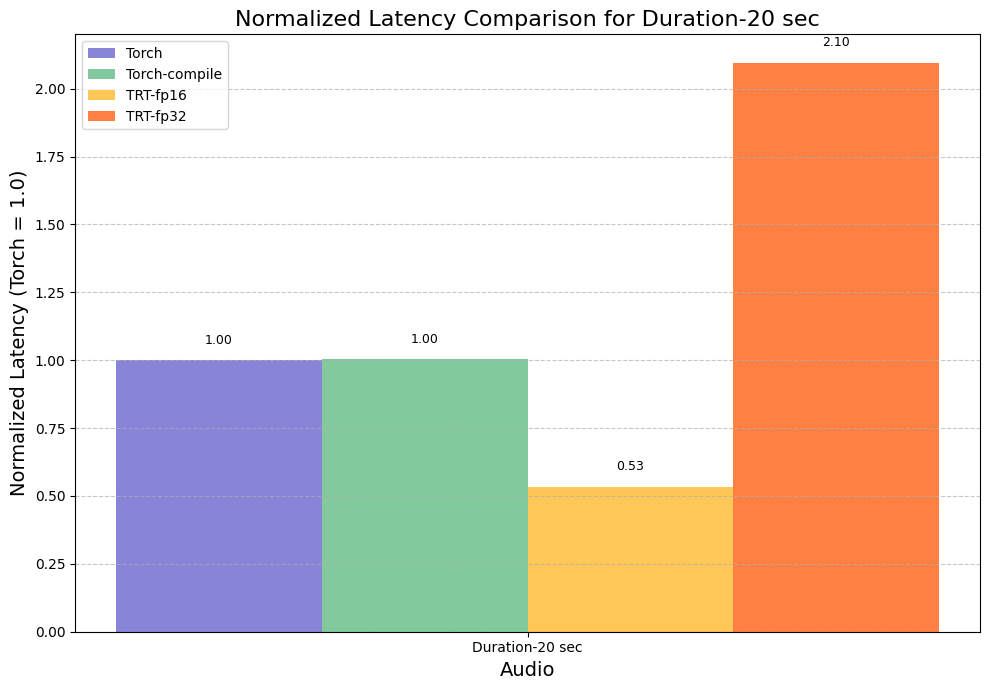


Original Values for Duration-20 sec:
{'Audio': 1.0, 'Torch': 0.8351121703162789, 'Torch-compile': 0.8372681991197168, 'TRT-fp16': 0.4453718808013945, 'TRT-fp32': 1.7498704694444314}

Normalized Values for Duration-20 sec:
{'Torch': np.float64(1.0), 'Torch-compile': np.float64(1.0025817236056103), 'TRT-fp16': np.float64(0.5333078556773043), 'TRT-fp32': np.float64(2.0953717735687043)}

Performance Improvement vs Torch:
Torch-compile: -0.26%
TRT-fp16: 46.67%
TRT-fp32: -109.54%


In [40]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Read the CSV file
df = pd.read_csv('inference_summary_all_texts_16.csv')

# Filter for only the second audio instance (index 1)
df_filtered = df.iloc[[1]]

# Set figure size
plt.figure(figsize=(10, 7))

# Set up position for the bars
x = np.array([0])  # Just one position now
width = 0.2  # Width of each bar

# Calculate normalized values (relative to Torch) for the second audio only
normalized_values = {
    'Torch': df_filtered['Torch'] / df_filtered['Torch'],  # This will always be 1.0
    'Torch-compile': df_filtered['Torch-compile'] / df_filtered['Torch'],
    'TRT-fp16': df_filtered['TRT-fp16'] / df_filtered['Torch'],
    'TRT-fp32': df_filtered['TRT-fp32'] / df_filtered['Torch']
}

# Create the bars for each format with normalized values
plt.bar(x - width*1.5, normalized_values['Torch'], width, label='Torch', color='#8884d8')
plt.bar(x - width/2, normalized_values['Torch-compile'], width, label='Torch-compile', color='#82ca9d')
plt.bar(x + width/2, normalized_values['TRT-fp16'], width, label='TRT-fp16', color='#ffc658')
plt.bar(x + width*1.5, normalized_values['TRT-fp32'], width, label='TRT-fp32', color='#ff8042')

# Add labels, title and legend
plt.xlabel('Audio', fontsize=14)
plt.ylabel('Normalized Latency (Torch = 1.0)', fontsize=14)
plt.title('Normalized Latency Comparison for Duration-20 sec', fontsize=16)
plt.xticks(x, ["Duration-20 sec"])
plt.legend(loc='upper left')

# Add grid for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Add value labels on top of bars with normalized values
for i, format_name in enumerate(['Torch', 'Torch-compile', 'TRT-fp16', 'TRT-fp32']):
    position = x[0] - width*1.5 + i*width
    value = normalized_values[format_name].iloc[0]  # Get the scalar value
    plt.text(position, value + 0.05, f'{value:.2f}', 
             ha='center', va='bottom', fontsize=9, rotation=0)

# Adjust layout and save
plt.tight_layout()
plt.savefig('duration_20sec_comparison.png', dpi=300)

# Display the plot
plt.show()

# Print original values for the second audio
print("\nOriginal Values for Duration-20 sec:")
print(df_filtered.iloc[0].to_dict())

# Print normalized values for the second audio
print("\nNormalized Values for Duration-20 sec:")
normalized_dict = {k: v.iloc[0] for k, v in normalized_values.items()}
print(normalized_dict)

# Calculate performance improvement percentages for the second audio
print("\nPerformance Improvement vs Torch:")
for format_name in ['Torch-compile', 'TRT-fp16', 'TRT-fp32']:
    improvement = ((df_filtered['Torch'] - df_filtered[format_name]) / df_filtered['Torch'] * 100).iloc[0]
    print(f"{format_name}: {improvement:.2f}%")

In [2]:
import cv2
import os

def extract_frames(video_path, output_folder, frame_indices=None, time_stamps=None, frame_interval=None):
    """
    Extract frames from a video file.
    
    Parameters:
    - video_path: Path to the video file
    - output_folder: Folder to save extracted frames
    - frame_indices: List of specific frame indices to extract (optional)
    - time_stamps: List of timestamps in seconds to extract frames from (optional)
    - frame_interval: Extract frames at this interval (e.g., every 30 frames) (optional)
    """
    # Create output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    print(frame_indices)
    # Open the video file
    video = cv2.VideoCapture(video_path)
    
    # Get video properties
    fps = video.get(cv2.CAP_PROP_FPS)
    total_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
    
    print(f"Video FPS: {fps}")
    print(f"Total frames: {total_frames}")
    
    
    # Extract frames by timestamps (in seconds)
    if time_stamps:
        for ts in time_stamps:
            # Convert timestamp to frame number
            curr_frame_idx = int(ts * fps)
            frame_indices=[]
            for frame_idx in range(curr_frame_idx, curr_frame_idx+int(fps)):

             if 0 <= frame_idx < total_frames:
                # Set video to the specific frame
                video.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
                ret, frame = video.read()
                
                if ret:
                    output_path = os.path.join(output_folder, f"{ts-5}_{frame_idx}.jpg")
                    cv2.imwrite(output_path, frame)
                    print(f"Saved frame at {ts}s to {output_path}")
                else:
                    print(f"Failed to read frame at timestamp {ts}s")
             else:
                print(f"Frame index {frame_idx} for timestamp {ts}s out of range (0-{total_frames-1})")
    
    
    
    # Release the video
    video.release()
    print("Extraction complete!")

# Example usage:
if __name__ == "__main__":
    video_path = "C:/Users/Admin/Downloads/Bajirao.Mastani.2015.720p.BluRay.x264.Hindi.AAC-ETRG (1).mp4"  # Replace with your video path
    
    output_folder = "extracted_frames"  # Output folder name
    
    # Example 1: Extract specific frames by their indices
    # extract_frames(video_path, output_folder, frame_indices=[0, 100, 200, 300])
    
    # Example 2: Extract frames at specific timestamps (in seconds)
    # extract_frames(video_path, output_folder, time_stamps=[0, 10, 20, 30])
    
    # Example 3: Extract frames at regular intervals (every 30 frames)
    extract_frames(video_path, output_folder, time_stamps=[8977],) #frame_interval=30)

None
Video FPS: 24.0
Total frames: 227562
Saved frame at 8977s to extracted_frames\8972_215448.jpg
Saved frame at 8977s to extracted_frames\8972_215449.jpg
Saved frame at 8977s to extracted_frames\8972_215450.jpg
Saved frame at 8977s to extracted_frames\8972_215451.jpg
Saved frame at 8977s to extracted_frames\8972_215452.jpg
Saved frame at 8977s to extracted_frames\8972_215453.jpg
Saved frame at 8977s to extracted_frames\8972_215454.jpg
Saved frame at 8977s to extracted_frames\8972_215455.jpg
Saved frame at 8977s to extracted_frames\8972_215456.jpg
Saved frame at 8977s to extracted_frames\8972_215457.jpg
Saved frame at 8977s to extracted_frames\8972_215458.jpg
Saved frame at 8977s to extracted_frames\8972_215459.jpg
Saved frame at 8977s to extracted_frames\8972_215460.jpg
Saved frame at 8977s to extracted_frames\8972_215461.jpg
Saved frame at 8977s to extracted_frames\8972_215462.jpg
Saved frame at 8977s to extracted_frames\8972_215463.jpg
Saved frame at 8977s to extracted_frames\8972_

In [5]:
import cv2
import os
import json

def extract_frames(video_path, output_folder, frame_indices=None, time_stamps=None, frame_interval=None, json_file=None):
    """
    Extract frames from a video file.
    
    Parameters:
    - video_path: Path to the video file
    - output_folder: Folder to save extracted frames
    - frame_indices: List of specific frame indices to extract (optional)
    - time_stamps: List of timestamps in seconds to extract frames from (optional)
    - frame_interval: Extract frames at this interval (e.g., every 30 frames) (optional)
    - json_file: Path to JSON file containing timestamp information (optional)
    """
    # Create output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
        
    # Process JSON file if provided
    if json_file and os.path.exists(json_file):
        with open(json_file, 'r') as f:
            json_data = json.load(f)
            
        # Extract timestamps from filenames in JSON
        # Assuming the filename numbers like 7131 actually represent timestamps
        json_timestamps = []
        for item in json_data:
            if "image" in item and "downloaded_images/" in item["image"]:
                try:
                    # Extract timestamp from filename (e.g., "downloaded_images/7131.jpg" -> 7131 seconds)
                    timestamp = int(item["image"].split('/')[-1].split('.')[0])
                    json_timestamps.append(timestamp+5)
                except (ValueError, IndexError):
                    print(f"Couldn't extract timestamp from {item['image']}")
        
        print(f"Extracted {len(json_timestamps)} timestamps from JSON file: {json_timestamps}")
        
        # Add these timestamps to any existing timestamps
        if time_stamps:
            time_stamps.extend(json_timestamps)
        else:
            time_stamps = json_timestamps
    
    # Open the video file
    video = cv2.VideoCapture(video_path)
    if not video.isOpened():
        print(f"Error: Could not open video file {video_path}")
        return
    
    # Get video properties
    fps = video.get(cv2.CAP_PROP_FPS)
    total_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
    duration = total_frames / fps if fps > 0 else 0
    
    print(f"Video FPS: {fps}")
    print(f"Total frames: {total_frames}")
    print(f"Video duration: {duration:.2f} seconds")
    
    # Extract frames by indices
    if frame_indices:
        for idx in frame_indices:
            if 0 <= idx < total_frames:
                # Set video to the specific frame
                video.set(cv2.CAP_PROP_POS_FRAMES, idx)
                ret, frame = video.read()
                
                if ret:
                    output_path = os.path.join(output_folder, f"frame_{idx}.jpg")
                    cv2.imwrite(output_path, frame)
                    print(f"Saved frame {idx} to {output_path}")
                else:
                    print(f"Failed to read frame {idx}")
            else:
                print(f"Frame index {idx} out of range (0-{total_frames-1})")
    
    # Extract frames by timestamps (in seconds)
    time_stamps=[int(i) for i in range(total_frames)]
    if time_stamps:
        for ts in time_stamps:
            # Convert timestamp to frame number
             frame_idx = int(ts * fps)
             frame_indices=[]
             #for frame_idx in range(curr_frame_idx, curr_frame_idx+int(fps)):

             if 0 <= frame_idx < total_frames:
                # Set video to the specific frame
                video.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
                ret, frame = video.read()
                
                if ret:
                    output_path = os.path.join(output_folder, f"{ts}.jpg")
                    cv2.imwrite(output_path, frame)
                    print(f"Saved frame at {ts}s to {output_path}")
                else:
                    print(f"Failed to read frame at timestamp {ts}s")
             else:
                print(f"Frame index {frame_idx} for timestamp {ts}s out of range (0-{total_frames-1})")
    
    # Extract frames at regular intervals
    if frame_interval:
        frame_count = 0
        saved_count = 0
        
        while True:
            ret, frame = video.read()
            if not ret:
                break
                
            if frame_count % frame_interval == 0:
                output_path = os.path.join(output_folder, f"interval_frame_{frame_count}.jpg")
                cv2.imwrite(output_path, frame)
                saved_count += 1
                
            frame_count += 1
            
        print(f"Saved {saved_count} frames at interval {frame_interval}")
    
    # Release the video
    video.release()
    print("Extraction complete!")

# Example usage:
if __name__ == "__main__":
    video_path = "C:/Users/Admin/Downloads/Bajirao.Mastani.2015.720p.BluRay.x264.Hindi.AAC-ETRG (1).mp4"
    output_folder = "extracted_frames"
    json_file = "C:/Users/Admin/Downloads/refined_images.json"  # Path to your JSON file
    
    # Example: Extract frames based on the JSON file (treating JSON numbers as timestamps)
    extract_frames(
        video_path=video_path,
        output_folder=output_folder,
        json_file=json_file
    )
    
    # If you want to extract additional specific timestamps as well
    # extract_frames(
    #     video_path=video_path,
    #     output_folder=output_folder,
    #     json_file=json_file,
    #     time_stamps=[8200]
    # )

Extracted 4666 timestamps from JSON file: [6, 11, 14, 17, 21, 26, 30, 35, 39, 40, 41, 44, 91, 96, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 116, 117, 118, 119, 120, 121, 122, 124, 125, 126, 127, 140, 143, 144, 155, 160, 164, 167, 168, 172, 180, 181, 183, 184, 186, 187, 188, 190, 191, 194, 195, 204, 208, 212, 214, 217, 223, 224, 225, 228, 229, 230, 232, 233, 236, 237, 239, 241, 242, 249, 250, 251, 252, 253, 257, 262, 266, 267, 268, 270, 273, 274, 276, 280, 281, 285, 287, 288, 297, 298, 308, 316, 317, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 332, 333, 334, 335, 336, 337, 339, 341, 343, 347, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 363, 366, 367, 369, 370, 371, 373, 380, 383, 386, 388, 389, 390, 391, 396, 399, 405, 409, 410, 414, 427, 428, 431, 435, 439, 443, 444, 445, 446, 448, 449, 450, 454, 458, 459, 460, 461, 462, 463, 464, 465, 466, 467, 468, 469, 470, 471, 475, 477, 478, 479, 480, 481, 482, 483, 484, 485, 487, 490, 492, 495, 496, 497, 498, 499, 500

In [ ]:
iterate numbers from 1 to 9474 .
Check if numerical value is present in the downloaded images.
after arriving at that instant, from prev find or 0 if starting from first ,make a search for the for the frame with the closest match (MSE) when both downloaded image and extracted image are resized to be in same size.signal
Accept the frame, save it in the folder named extracted_frames with original dimensions and move to the next number.

In [14]:
import os
import cv2
import numpy as np
from pathlib import Path

def mse(img1, img2):
    """Calculate Mean Squared Error between two images"""
    # Convert images to same size for comparison
    h, w = img1.shape[:2]
    img2_resized = cv2.resize(img2, (w, h))
    
    # Calculate MSE
    err = np.sum((img1.astype("float") - img2_resized.astype("float")) ** 2)
    err /= float(img1.shape[0] * img1.shape[1])
    return err

def find_closest_match(downloaded_img, extracted_frames, prev_index=0):
    """Find the frame with the closest match using MSE"""
    min_error = float('inf')
    best_match_idx = -1
    
    # Start search from prev_index if specified, otherwise from beginning
    start_idx = prev_index if prev_index > 0 else 0
    
    # Search through all frames
    for i in range(start_idx, len(extracted_frames)):
        frame = extracted_frames[i]
        error = mse(downloaded_img, frame)
        
        if error < min_error:
            min_error = error
            best_match_idx = i
    
    return best_match_idx

def main():
    # Create output directory if it doesn't exist
    output_dir = Path("extracted_frames")
    output_dir.mkdir(exist_ok=True)
    
    # Path to downloaded images
    downloaded_images_dir ="downloaded_images"  # Update this path
    
    # Path to video or source of frames
    video_path = "C:/Users/Admin/Downloads/Bajirao.Mastani.2015.720p.BluRay.x264.Hindi.AAC-ETRG (1).mp4"  # Update this path
    
    # Extract all frames from video (or load pre-extracted frames)
    print("Loading video frames...")
    cap = cv2.VideoCapture(video_path)
    extracted_frames = []
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        extracted_frames.append(frame)
    cap.release()
    print(f"Loaded {len(extracted_frames)} frames from video")
    
    # Iterate through numbers 1 to 9474
    prev_found_idx = 0
    for num in range(1, 9475):
        print(f"Processing number {num}...")
        
        # Construct the filename pattern for the downloaded image
        # Adjust this pattern to match your downloaded image naming convention
        downloaded_img_path = downloaded_images_dir / f"{num}.jpg"
        
        # Check if downloaded image exists
        if not downloaded_img_path.exists():
            print(f"Warning: Downloaded image {downloaded_img_path} not found. Skipping.")
            continue
        
        # Load the downloaded image
        downloaded_img = cv2.imread(str(downloaded_img_path))
        if downloaded_img is None:
            print(f"Warning: Could not read image {downloaded_img_path}. Skipping.")
            continue
        
        # Find the closest matching frame
        match_idx = find_closest_match(downloaded_img, extracted_frames, prev_found_idx)
        
        if match_idx >= 0:
            # Save the matched frame with original dimensions
            output_path = output_dir / f"{num}.jpg"
            cv2.imwrite(str(output_path), extracted_frames[match_idx])
            print(f"Saved frame {match_idx} as {output_path}")
            
            # Update previous found index for next search
            prev_found_idx = match_idx
        else:
            print(f"Warning: No matching frame found for {num}")
    
    print("Frame extraction complete!")

if __name__ == "__main__":
    main()

Loading video frames...


KeyboardInterrupt: 